## Set of tools and examples of how to read in vtk/vti files ##

In [38]:
%matplotlib notebook
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

from matplotlib.colors import LogNorm
import os
import numpy as np
import vtk
from vtk.util import numpy_support as vtk_np

# Function for reading in pvtis and returns
# img = array of values, will be 3D if it is a scalar and 4D if it is a vector
# dim = the size of the array in each direction
# spacing = the grid spacing in each direction
def pvti_readin(filename):

	reader = vtk.vtkXMLPImageDataReader()
	reader.SetFileName(filename)
	reader.Update()

	data = reader.GetOutput()
	dim = data.GetDimensions()
	spacing = np.array(data.GetSpacing())

	v = vtk_np.vtk_to_numpy(data.GetCellData().GetArray(0))
	n_comp = data.GetCellData().GetArray(0).GetNumberOfComponents()
	
	vec = [int(i-1) for i in dim]

	if(n_comp > 1):
		vec.append(n_comp)

	if(n_comp > 2):
		img = v.reshape(vec,order="F")[0:dim[0]-1,0:dim[1]-1,0:dim[2]-1,:]
	else:
		img = v.reshape(vec,order="F")[0:dim[0]-1,0:dim[1]-1,0:dim[2]-1]
	dim = img.shape
	return img,dim,spacing

The function pvti_reader takes the filename and reads the data into the multiD array img, it also so returns the size of that array and the spacing of the computational grid in each direction

Example of reading in electron density and current density data for 1 timestep, the timestamp appears in the filename after "-" and is in ns.

In [17]:
rho_2_ions_per_cm3 = 27* 1.66e-27*1e6

base_folder = '/home/jdhare/GORGON/nsf_puffin/reconnection2D/'
run = 'xy00'
quantity ='rho'
time = 360
fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
file = os.path.join(base_folder,run, fn)

rho,dim,spacing = pvti_readin(file)
#jvec,dim,spacing = pvti_readin("/home/jdhare/GORGON/xy07/x07_jvec-150.pvti")

# Produce the Cartesian position coordinates centred on the centre of the grid

x = spacing[0]*(np.arange(dim[0])-dim[0]//2+0.5)
y = spacing[1]*(np.arange(dim[1])-dim[1]//2+0.5)
z = spacing[2]*(np.arange(dim[2])-dim[2]//2+0.5)

# Define the x,y,z midplane indices

xm_idx = dim[0]//2
ym_idx = dim[1]//2
zm_idx = dim[2]//2

# Define extent in mm
x_ext = xm_idx*spacing[0]*1e3
y_ext = ym_idx*spacing[0]*1e3

## Lineouts

<IPython.core.display.Javascript object>


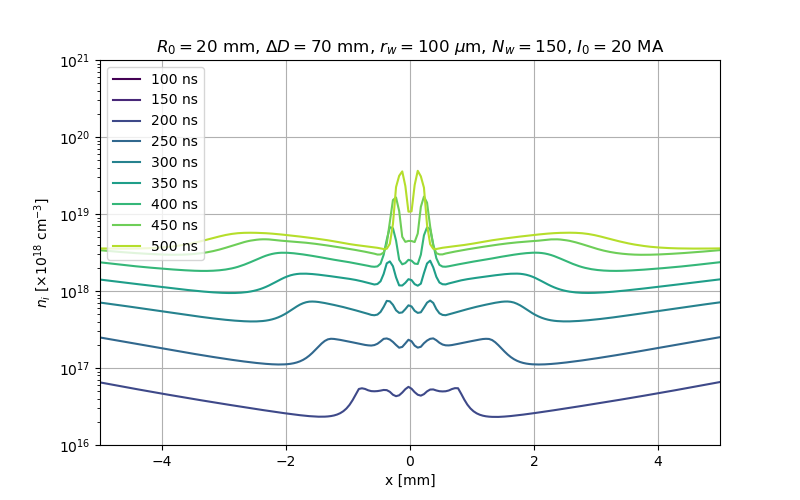

In [143]:
run = 'xy00'
quantity ='rho'

fig, ax = plt.subplots(figsize = (8,5))

ax.set_prop_cycle('color',[plt.cm.viridis(i) for i in np.linspace(0, 1, 10)])

for t in np.arange(100,510,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    rho,dim,spacing = pvti_readin(file)


    n_i = rho/rho_2_ions_per_cm3
    Δy = 1e-3/spacing[0]
    n_i_x = n_i[:,int(ym_idx-Δy):int(ym_idx+Δy),zm_idx].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.semilogy(x*1e3,n_i_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([1e16,1e21])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$n_i$ [$\times 10^{18}$ cm$^{-3}$]')

ax.legend(loc = 2, fontsize=10)
xy00_str = r'$R_0 = 20$ mm, $\Delta D = 70$ mm, $r_w = 100$ $\mu$m, $N_w=$150, $I_0 = 20$ MA'
ax.set_title(xy00_str);

<IPython.core.display.Javascript object>


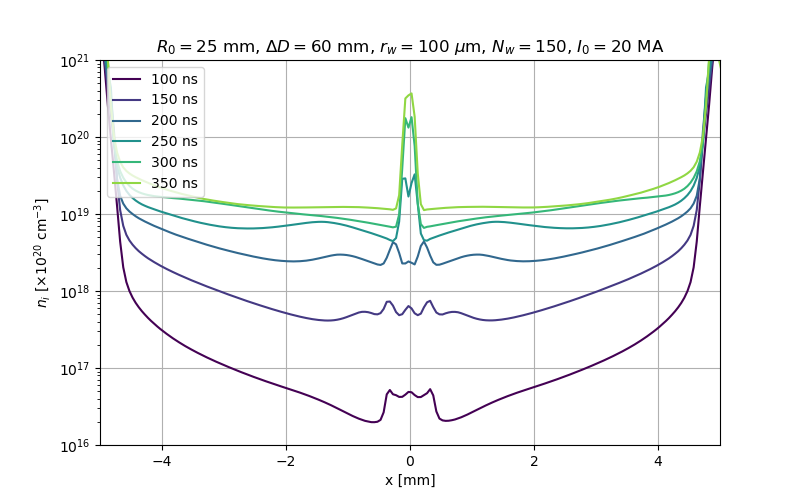

Text(0.5, 1.0, '$R_0 = 25$ mm, $\\Delta D = 60$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [19]:
run = 'xy02'
quantity ='rho'

fig, ax = plt.subplots(figsize = (8,5))

ax.set_prop_cycle('color',[plt.cm.viridis(i) for i in np.linspace(0, 1, 7)])

for t in np.arange(100,380,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    rho,dim,spacing = pvti_readin(file)


    n_i = rho/rho_2_ions_per_cm3
    Δy = 1e-3/spacing[0]
    n_i_x = n_i[:,int(ym_idx-Δy):int(ym_idx+Δy),zm_idx].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.semilogy(x*1e3,n_i_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([1e16,1e21])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$n_i$ [$\times 10^{20}$ cm$^{-3}$]')

ax.legend(loc = 2, fontsize=10)
xy02_str = r'$R_0 = 25$ mm, $\Delta D = 60$ mm, $r_w = 100$ $\mu$m, $N_w=$150, $I_0 = 20$ MA'
ax.set_title(xy02_str)

<IPython.core.display.Javascript object>


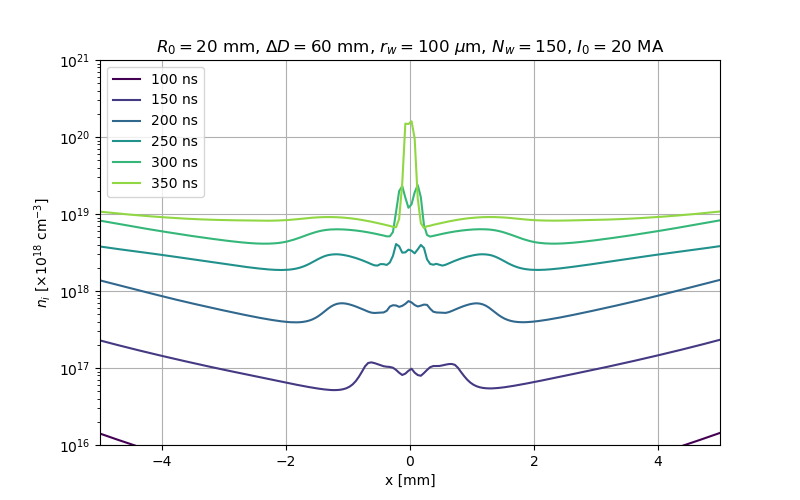

Text(0.5, 1.0, '$R_0 = 20$ mm, $\\Delta D = 60$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [32]:
run = 'xy03'
quantity ='rho'

fig, ax = plt.subplots(figsize = (8,5))

ax.set_prop_cycle('color',[plt.cm.viridis(i) for i in np.linspace(0, 1, 7)])

for t in np.arange(100,380,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    rho,dim,spacing = pvti_readin(file)


    n_i = rho/rho_2_ions_per_cm3
    Δy = 2e-3/spacing[0]
    n_i_x = n_i[:,int(ym_idx-Δy):int(ym_idx+Δy),zm_idx].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.semilogy(x*1e3,n_i_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([1e16,1e21])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$n_i$ [$\times 10^{18}$ cm$^{-3}$]')

ax.legend(loc = 2, fontsize=10)
xy03_str = r'$R_0 = 20$ mm, $\Delta D = 60$ mm, $r_w = 100$ $\mu$m, $N_w=$150, $I_0 = 20$ MA'
ax.set_title(xy03_str)

<IPython.core.display.Javascript object>


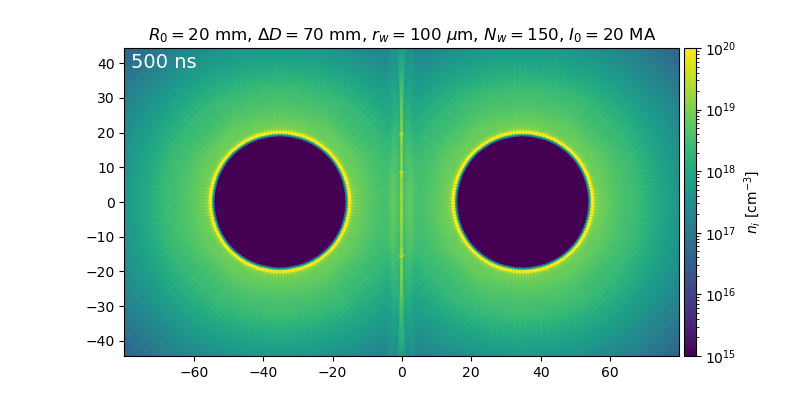

In [141]:
run = 'xy00'
quantity ='rho'
time = 500
fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
file = os.path.join(base_folder,run, fn)
rho,dim,spacing = pvti_readin(file)

n_i = rho/rho_2_ions_per_cm3

fig, ax = plt.subplots(figsize = (8,4))

im = ax.imshow(n_i[:,:,zm_idx].T, norm=LogNorm(vmin=1e15, vmax=1e20), extent=[-x_ext, x_ext, -y_ext, y_ext])
divider0 = make_axes_locatable(ax)
c = divider0.append_axes('right',size="2%", pad=0.05)
fig.colorbar(im, cax = c, label = r'$n_i$ [cm$^{-3}$]')

ax.text(-78, 43, str(time)+' ns', color='w', ha='left', va='top', fontsize=14)

ax.set_title(xy00_str);

<IPython.core.display.Javascript object>


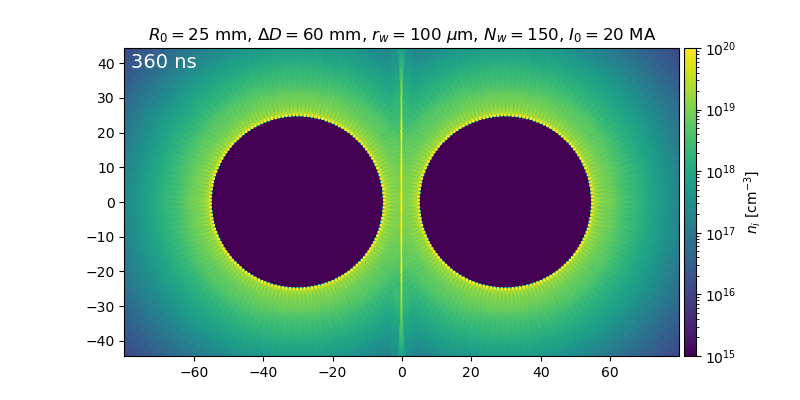

In [40]:
run = 'xy02'
quantity ='rho'
time = 360
fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
file = os.path.join(base_folder,run, fn)
rho,dim,spacing = pvti_readin(file)

n_i = rho/rho_2_ions_per_cm3

fig, ax = plt.subplots(figsize = (8,4))

im = ax.imshow(n_i[:,:,zm_idx].T, norm=LogNorm(vmin=1e15, vmax=1e20), extent=[-x_ext, x_ext, -y_ext, y_ext])
divider0 = make_axes_locatable(ax)
c = divider0.append_axes('right',size="2%", pad=0.05)
fig.colorbar(im, cax = c, label = r'$n_i$ [cm$^{-3}$]')


ax.text(-78, 43, str(time)+' ns', color='w', ha='left', va='top', fontsize=14)

ax.set_title(xy02_str);

<IPython.core.display.Javascript object>


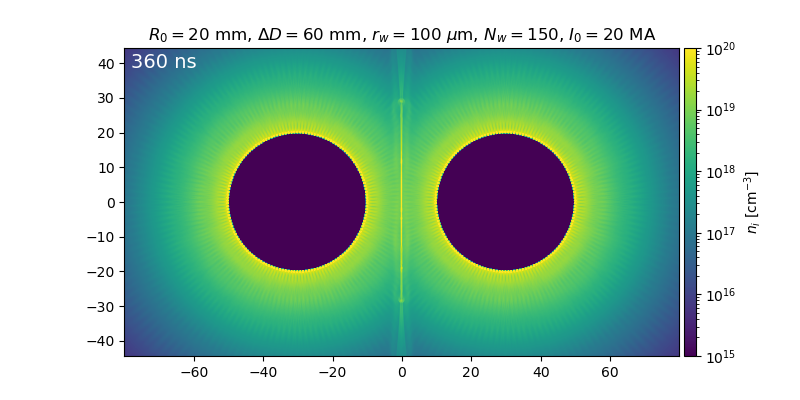

Text(0.5, 1.0, '$R_0 = 20$ mm, $\\Delta D = 60$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [34]:
run = 'xy03'
quantity ='rho'
time = 360
fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
file = os.path.join(base_folder,run, fn)
rho,dim,spacing = pvti_readin(file)

n_i = rho/rho_2_ions_per_cm3

fig, ax = plt.subplots(figsize = (8,4))

im = ax.imshow(n_i[:,:,zm_idx].T, norm=LogNorm(vmin=1e15, vmax=1e20), extent=[-x_ext, x_ext, -y_ext, y_ext])

divider0 = make_axes_locatable(ax)
c = divider0.append_axes('right',size="2%", pad=0.05)
fig.colorbar(im, cax = c, label = r'$n_i$ [cm$^{-3}$]')

ax.text(-78, 43, str(time)+' ns', color='w', ha='left', va='top', fontsize=14)

ax.set_title(xy03_str)

<IPython.core.display.Javascript object>


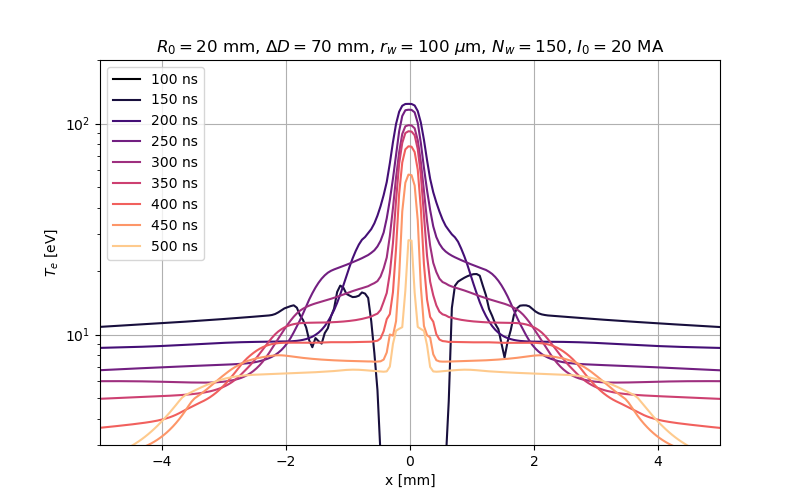

Text(0.5, 1.0, '$R_0 = 20$ mm, $\\Delta D = 70$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [142]:
run = 'xy00'
quantity ='Te'

fig, ax = plt.subplots(figsize = (8,5))

ax.set_prop_cycle('color',[plt.cm.magma(i) for i in np.linspace(0, 1, 10)])

for t in np.arange(100,510,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    Te,dim,spacing = pvti_readin(file)


    Δy = 1e-3/spacing[0]
    Te_x = Te[:,int(ym_idx-Δy):int(ym_idx+Δy),zm_idx].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.semilogy(x*1e3,Te_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([3,2e2])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$T_e$ [eV]')

ax.legend(loc = 2, fontsize=10)
 
ax.set_title(r'$R_0 = 20$ mm, $\Delta D = 70$ mm, $r_w = 100$ $\mu$m, $N_w=$150, $I_0 = 20$ MA')

<IPython.core.display.Javascript object>


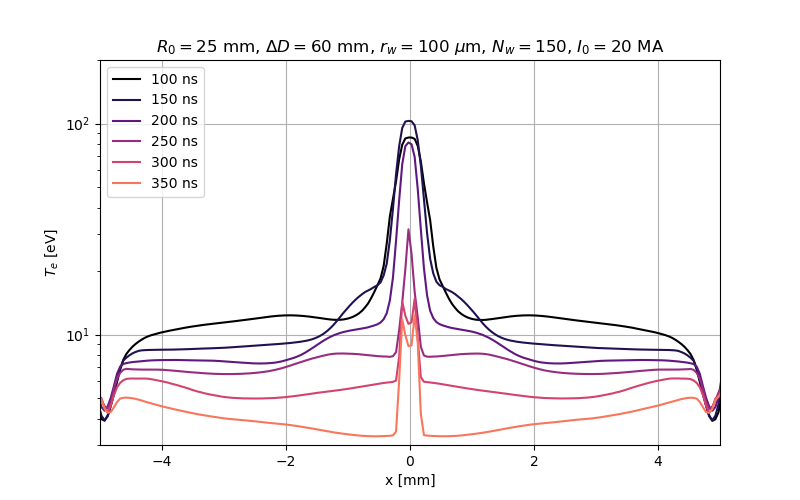

Text(0.5, 1.0, '$R_0 = 25$ mm, $\\Delta D = 60$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [152]:
run = 'xy02'
quantity ='Te'

fig, ax = plt.subplots(figsize = (8,5))

ax.set_prop_cycle('color',[plt.cm.magma(i) for i in np.linspace(0, 1, 8)])

for t in np.arange(100,380,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    Te,dim,spacing = pvti_readin(file)


    Δy = 1e-3/spacing[0]
    Te_x = Te[:,int(ym_idx-Δy):int(ym_idx+Δy),zm_idx].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.semilogy(x*1e3,Te_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([3,2e2])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$T_e$ [eV]')

ax.legend(loc = 2, fontsize=10)
 
ax.set_title(r'$R_0 = 25$ mm, $\Delta D = 60$ mm, $r_w = 100$ $\mu$m, $N_w=$150, $I_0 = 20$ MA')

<IPython.core.display.Javascript object>


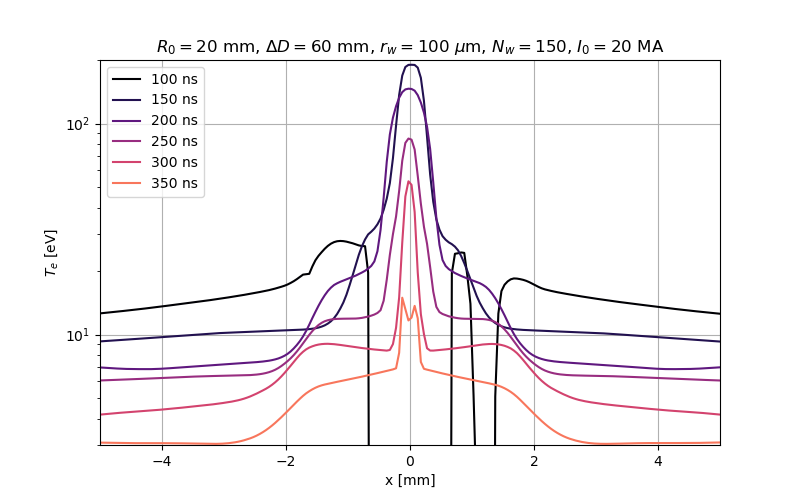

Text(0.5, 1.0, '$R_0 = 20$ mm, $\\Delta D = 60$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [28]:
run = 'xy03'
quantity ='Te'

fig, ax = plt.subplots(figsize = (8,5))

ax.set_prop_cycle('color',[plt.cm.magma(i) for i in np.linspace(0, 1, 8)])

for t in np.arange(100,380,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    Te,dim,spacing = pvti_readin(file)


    Δy = 1e-3/spacing[0]
    Te_x = Te[:,int(ym_idx-Δy):int(ym_idx+Δy),zm_idx].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.semilogy(x*1e3,Te_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([3,2e2])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$T_e$ [eV]')

ax.legend(loc = 2, fontsize=10)
 
ax.set_title(xy03_str)

<IPython.core.display.Javascript object>


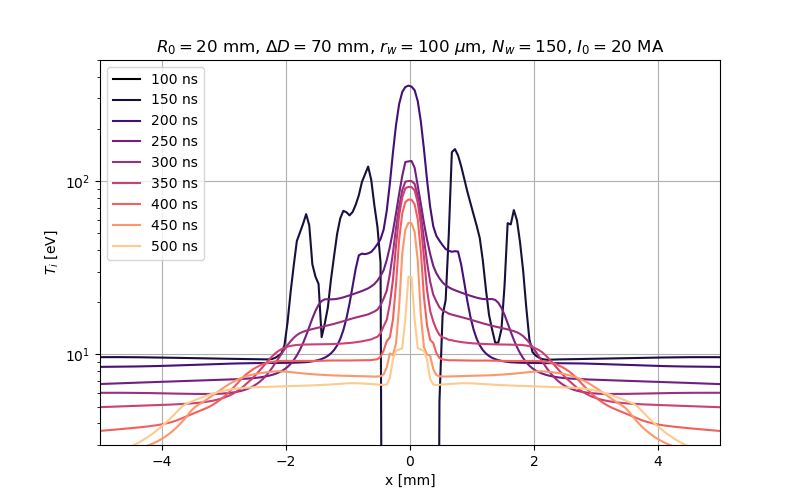

Text(0.5, 1.0, '$R_0 = 20$ mm, $\\Delta D = 70$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [144]:
run = 'xy00'
quantity ='Ti'

fig, ax = plt.subplots(figsize = (8,5))

ax.set_prop_cycle('color',[plt.cm.magma(i) for i in np.linspace(0, 1, 10)])

for t in np.arange(100,510,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    Te,dim,spacing = pvti_readin(file)


    Δy = 1e-3/spacing[0]
    Te_x = Te[:,int(ym_idx-Δy):int(ym_idx+Δy),zm_idx].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.semilogy(x*1e3,Te_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([3,5e2])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$T_i$ [eV]')

ax.legend(loc = 2, fontsize=10)
 
ax.set_title(r'$R_0 = 20$ mm, $\Delta D = 70$ mm, $r_w = 100$ $\mu$m, $N_w=$150, $I_0 = 20$ MA')

## Gifs

<IPython.core.display.Javascript object>


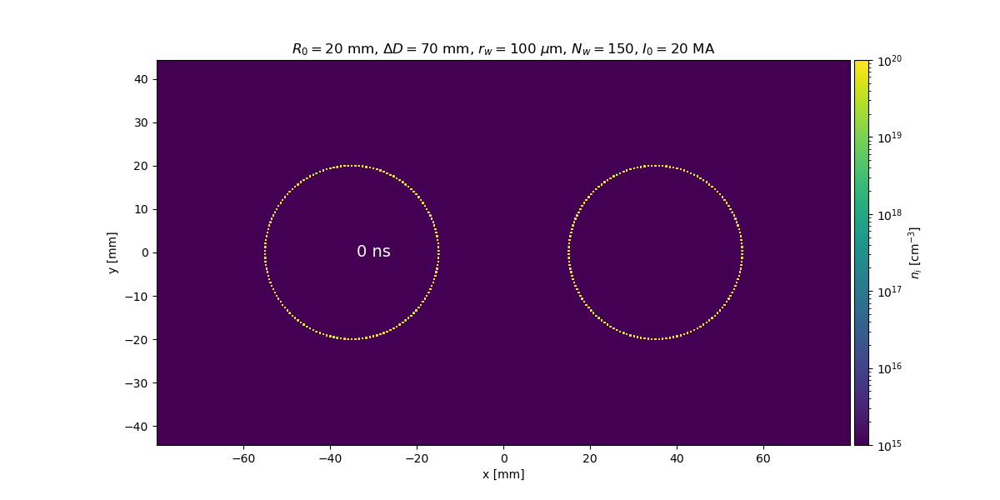

<IPython.core.display.Javascript object>


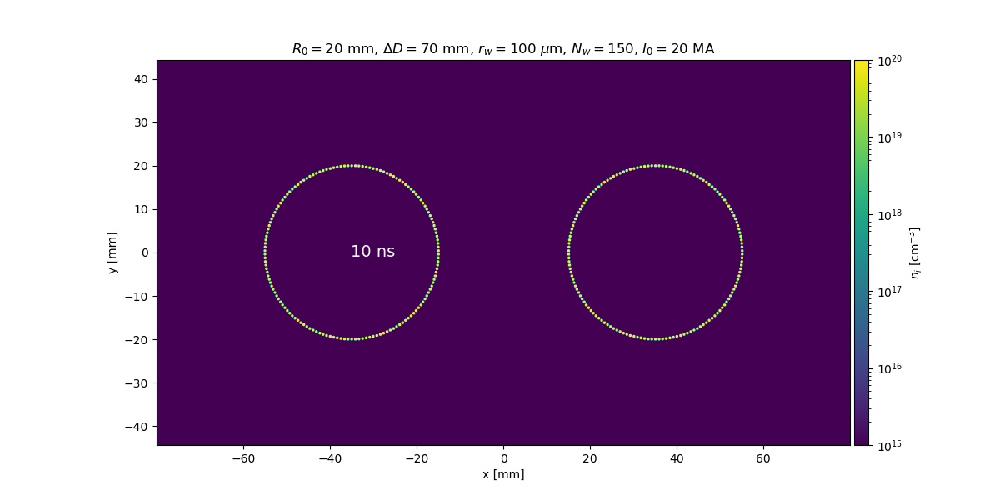

<IPython.core.display.Javascript object>


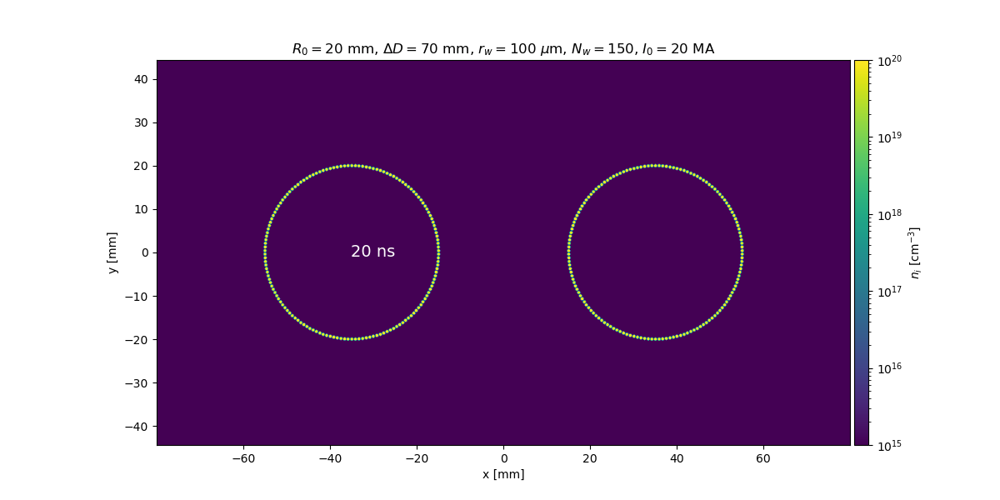

<IPython.core.display.Javascript object>


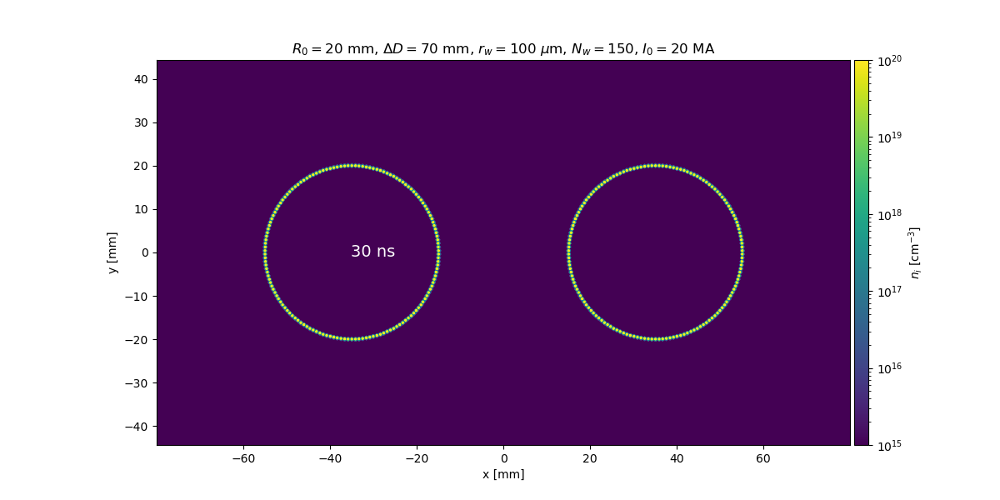

<IPython.core.display.Javascript object>


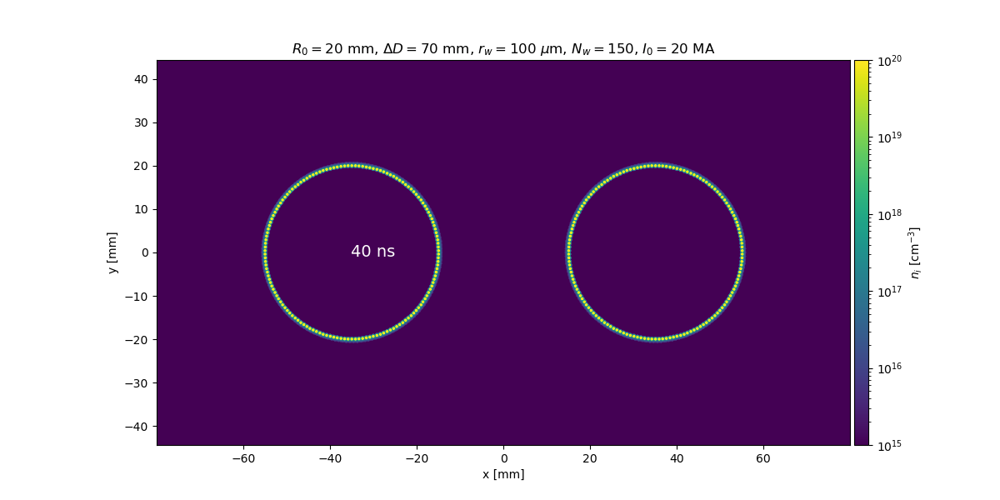

<IPython.core.display.Javascript object>


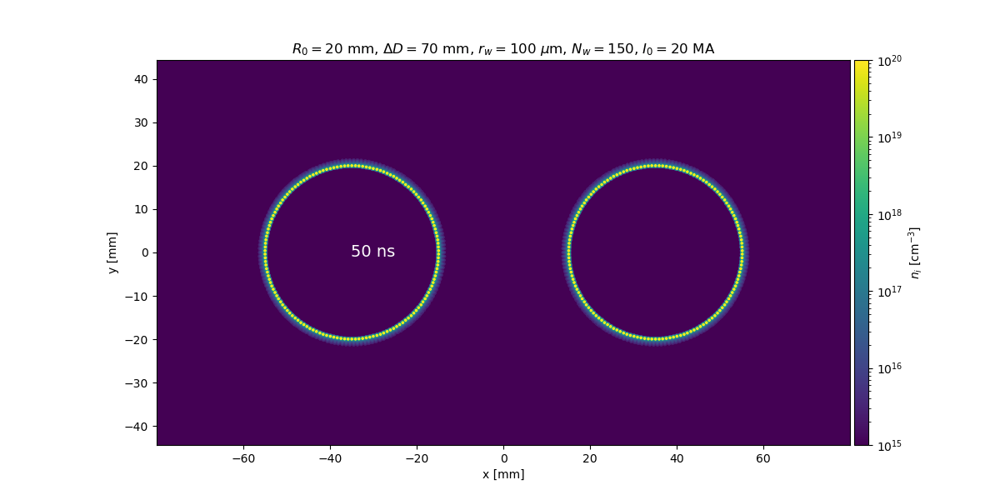

<IPython.core.display.Javascript object>


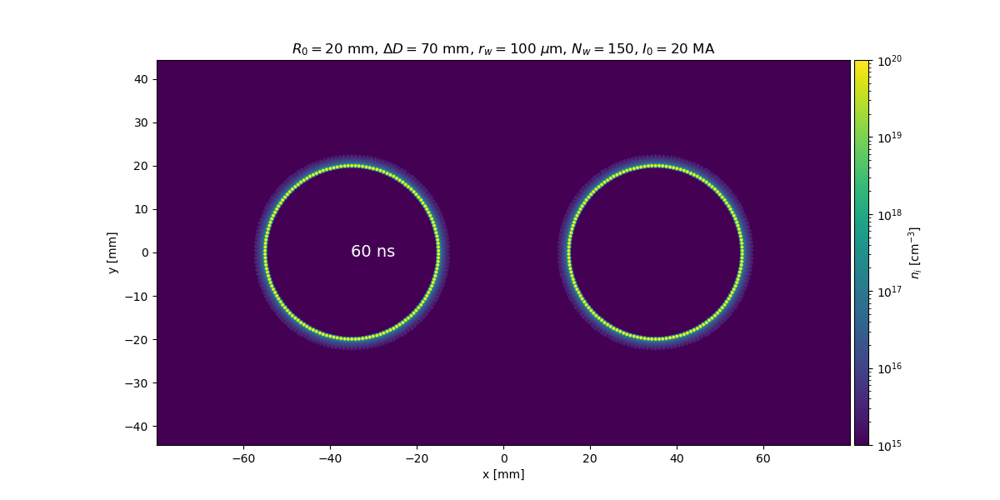

<IPython.core.display.Javascript object>


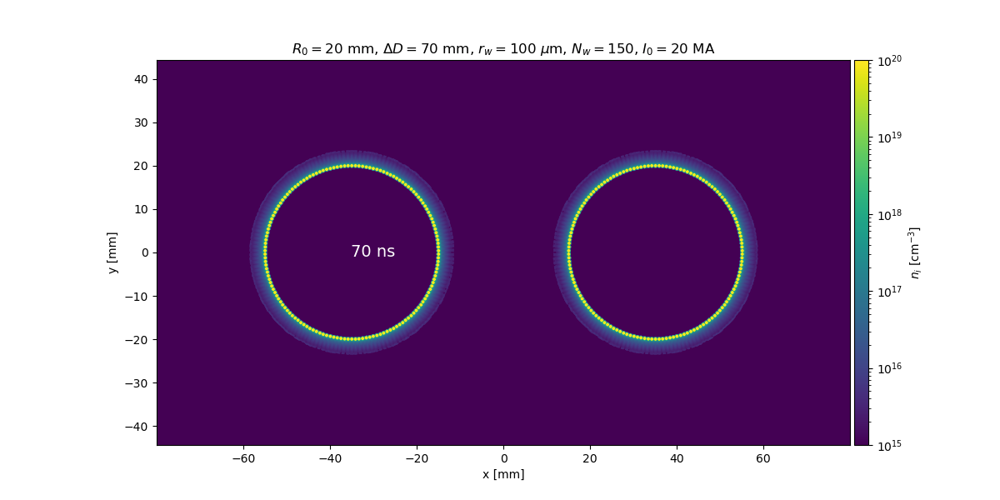

<IPython.core.display.Javascript object>


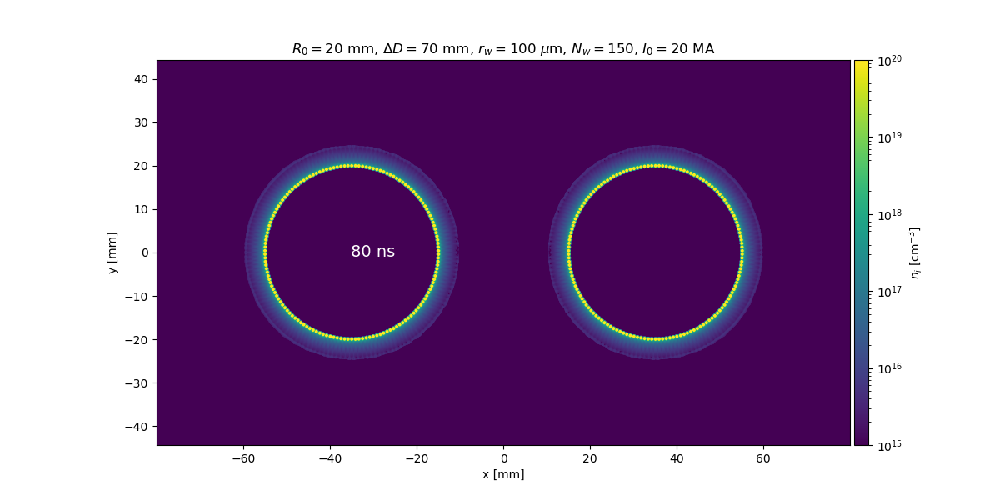

<IPython.core.display.Javascript object>


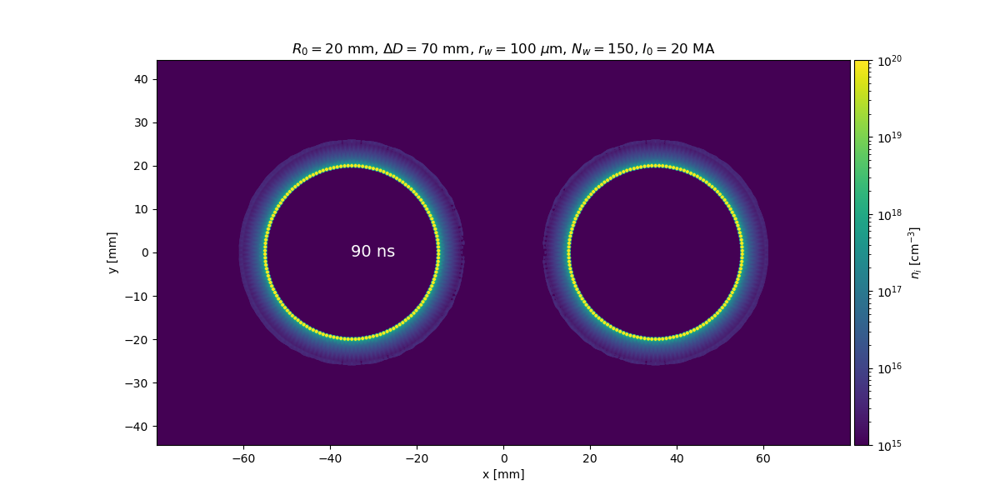

<IPython.core.display.Javascript object>


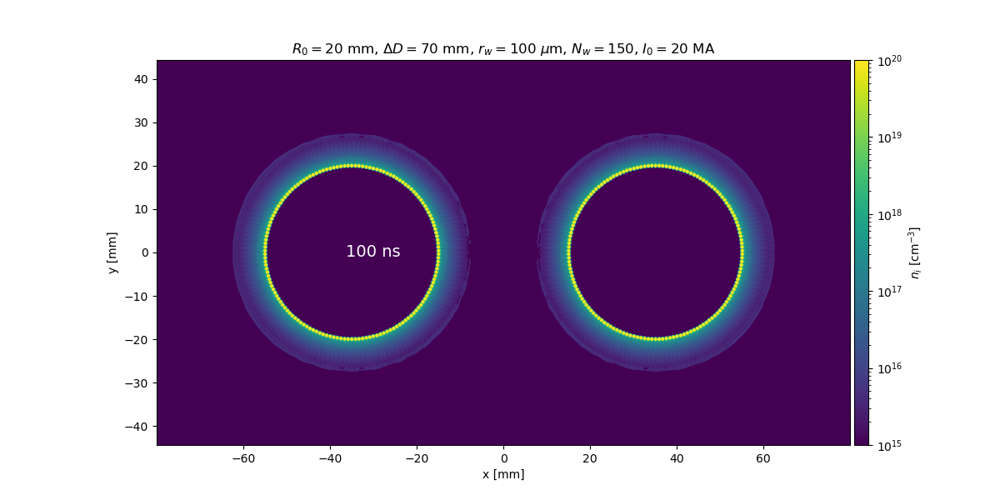

<IPython.core.display.Javascript object>


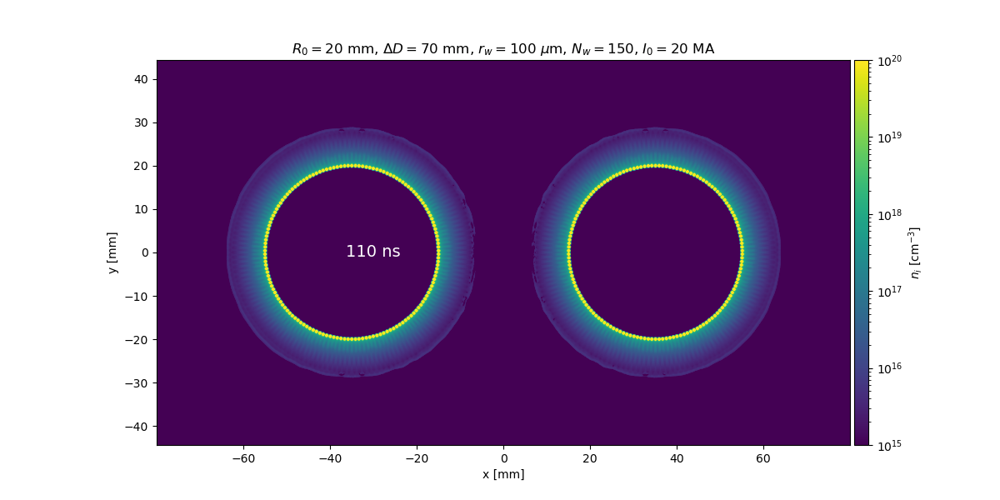

<IPython.core.display.Javascript object>


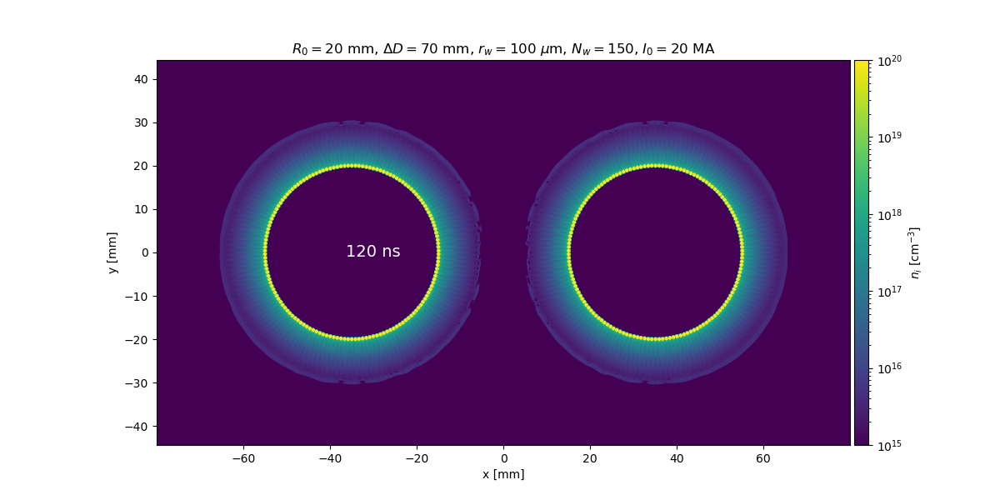

<IPython.core.display.Javascript object>


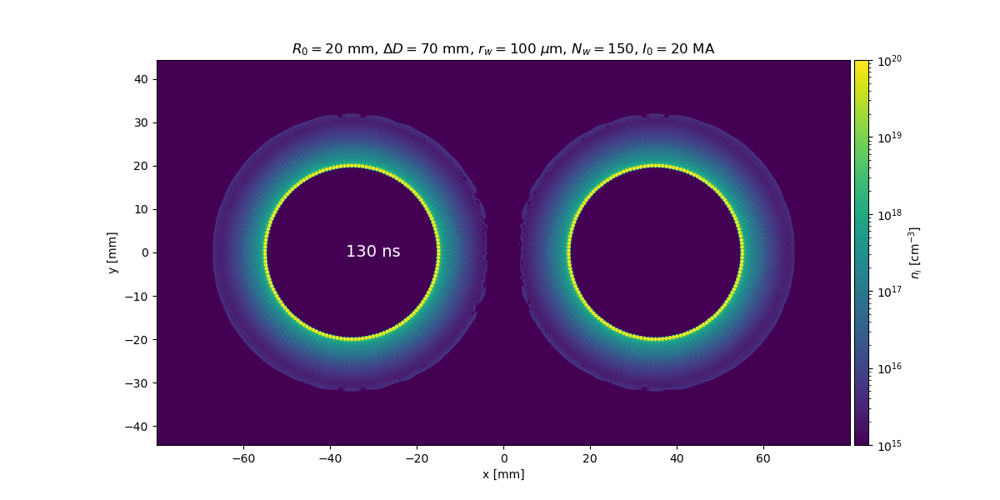

<IPython.core.display.Javascript object>


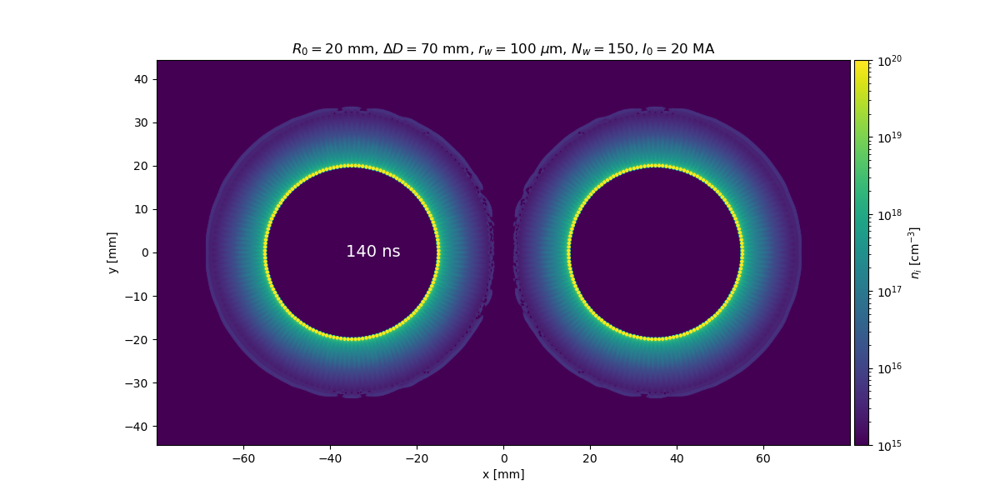

<IPython.core.display.Javascript object>


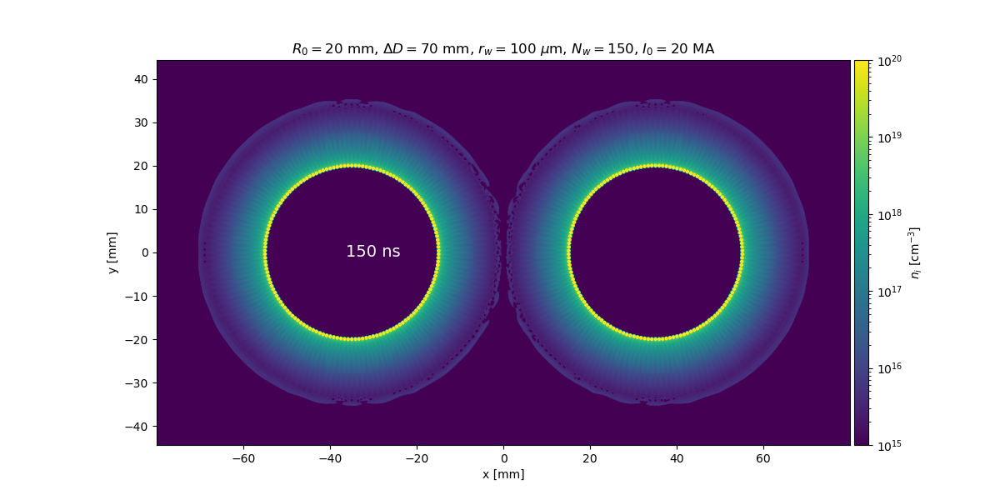

<IPython.core.display.Javascript object>


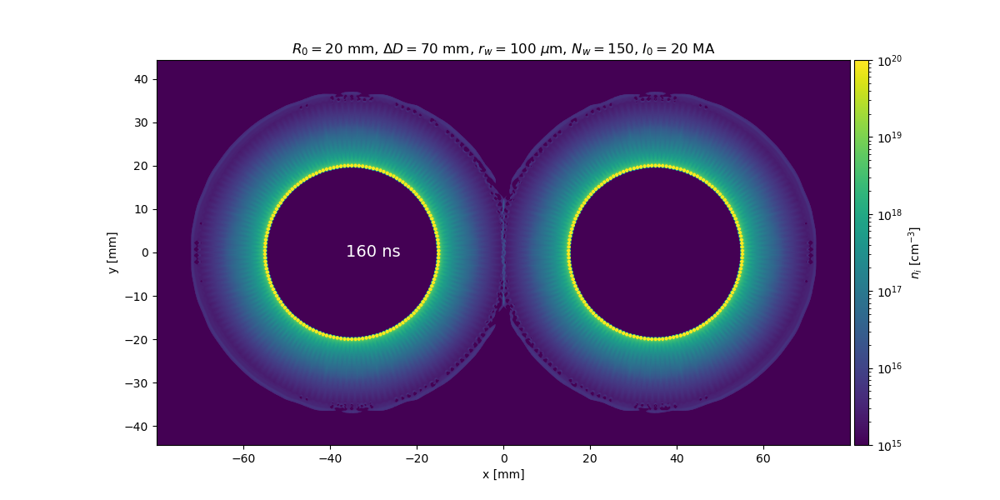

<IPython.core.display.Javascript object>


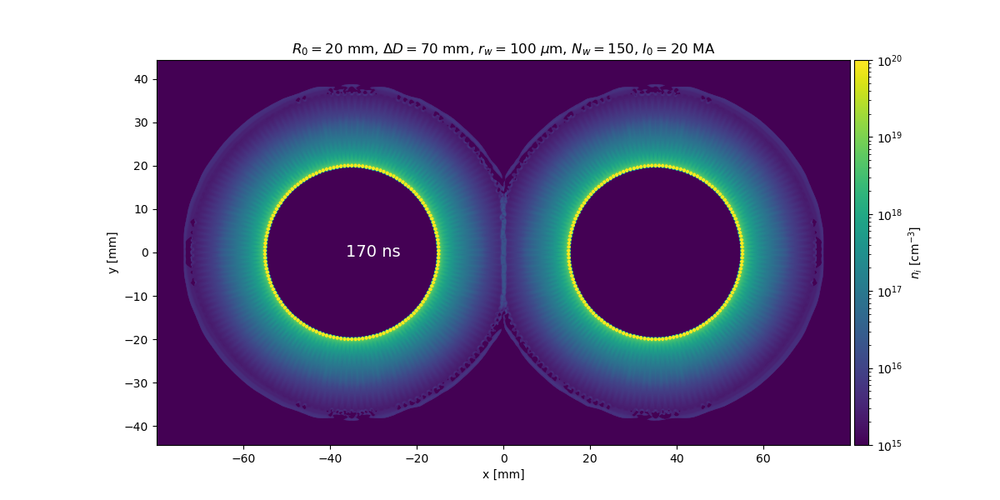

<IPython.core.display.Javascript object>


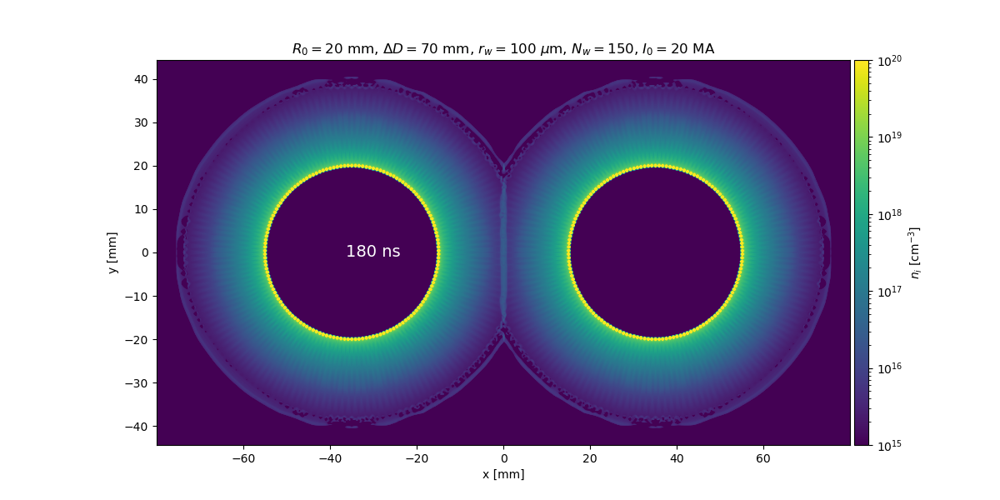

<IPython.core.display.Javascript object>


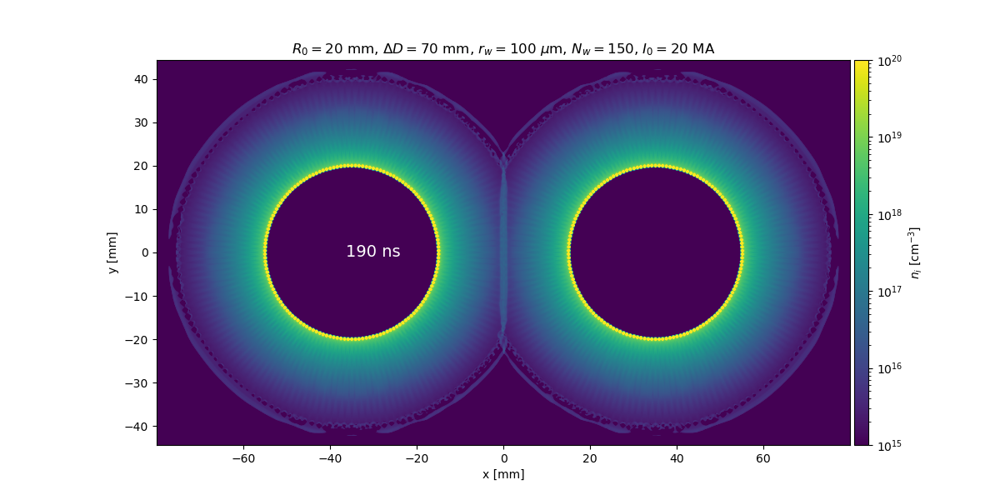

<IPython.core.display.Javascript object>


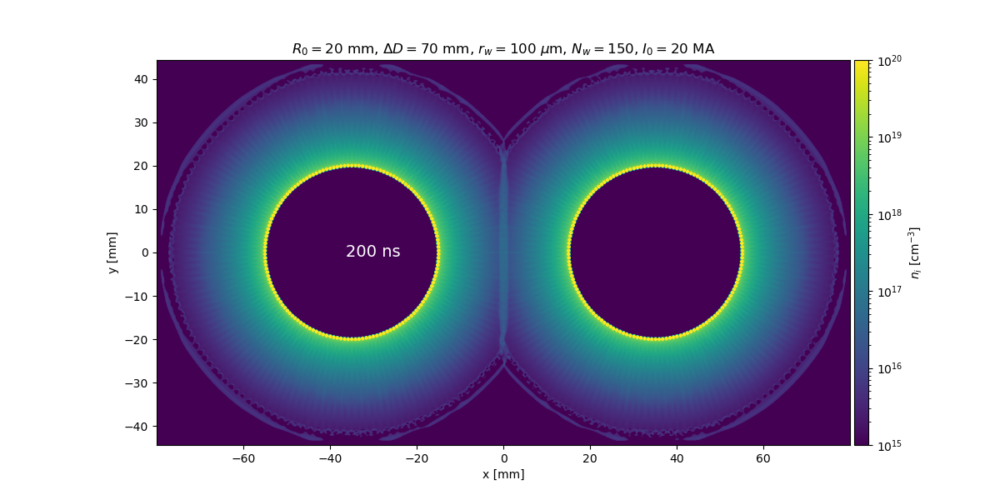

<IPython.core.display.Javascript object>


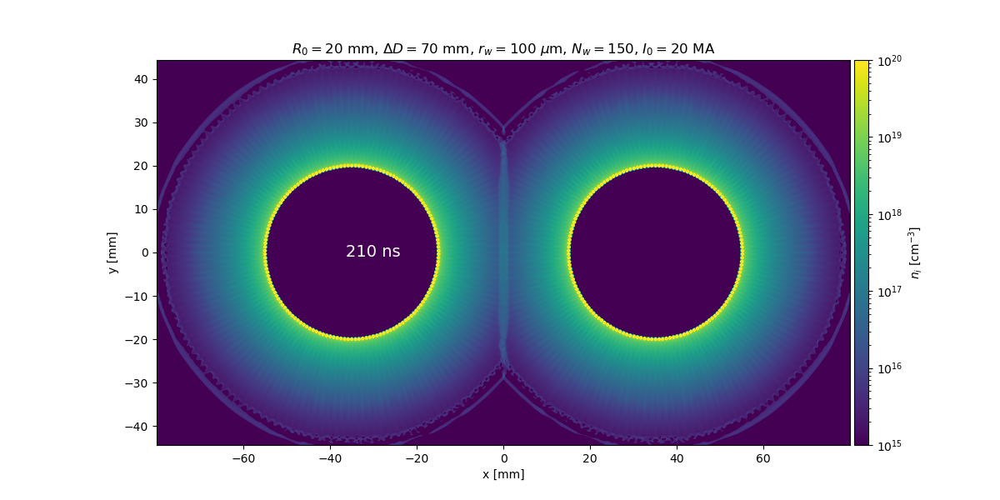

<IPython.core.display.Javascript object>


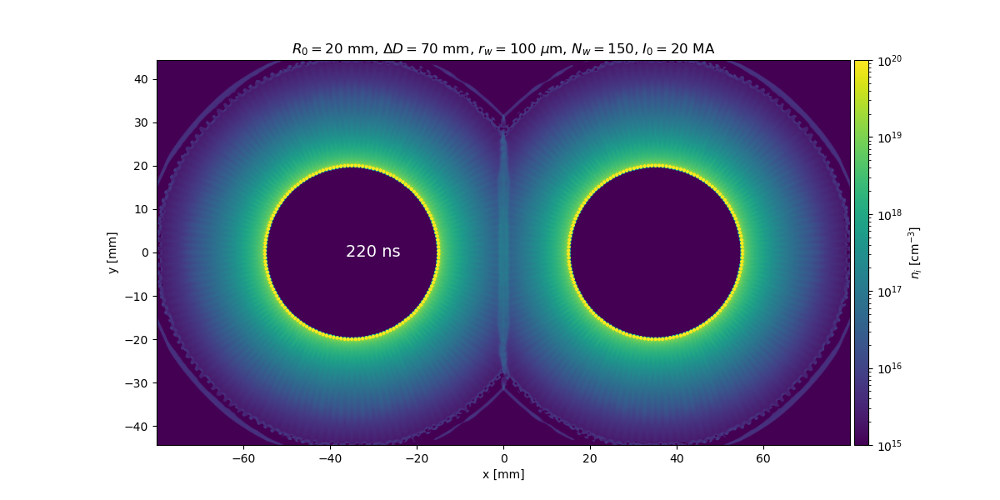

<IPython.core.display.Javascript object>


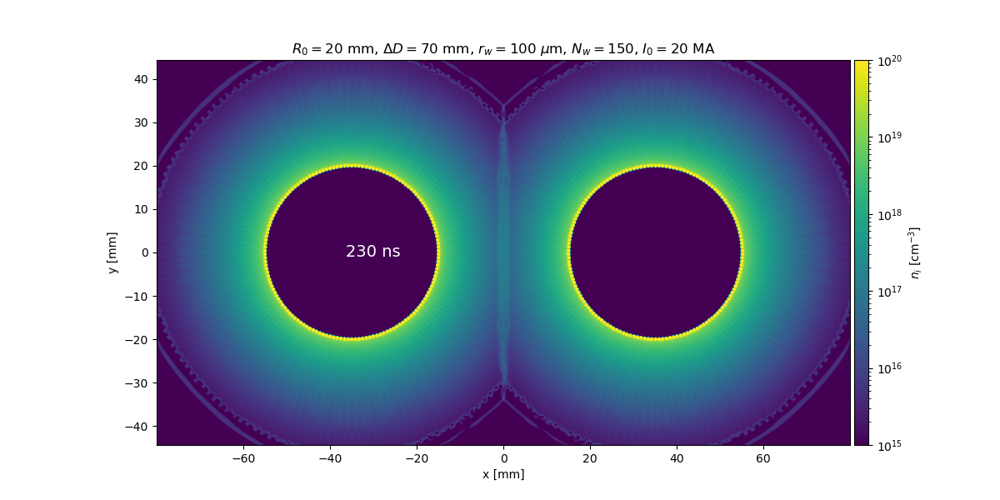

<IPython.core.display.Javascript object>


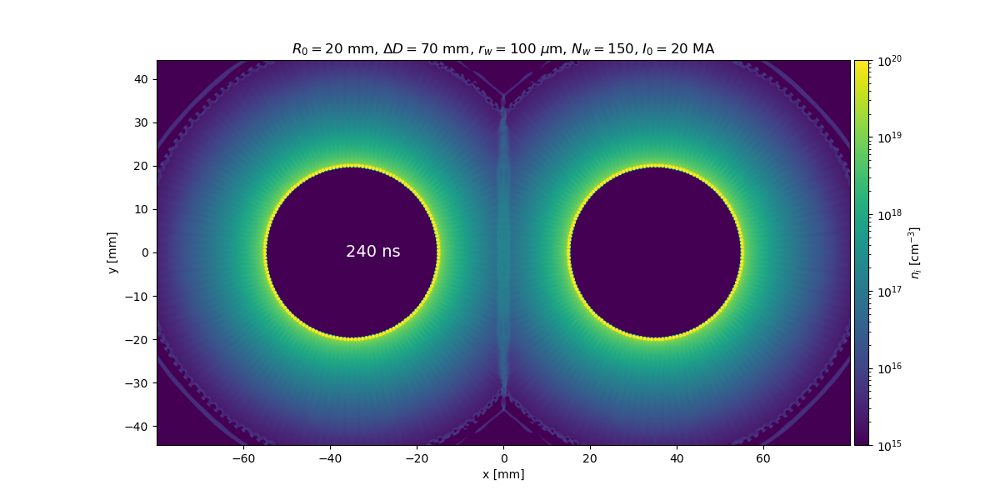

<IPython.core.display.Javascript object>


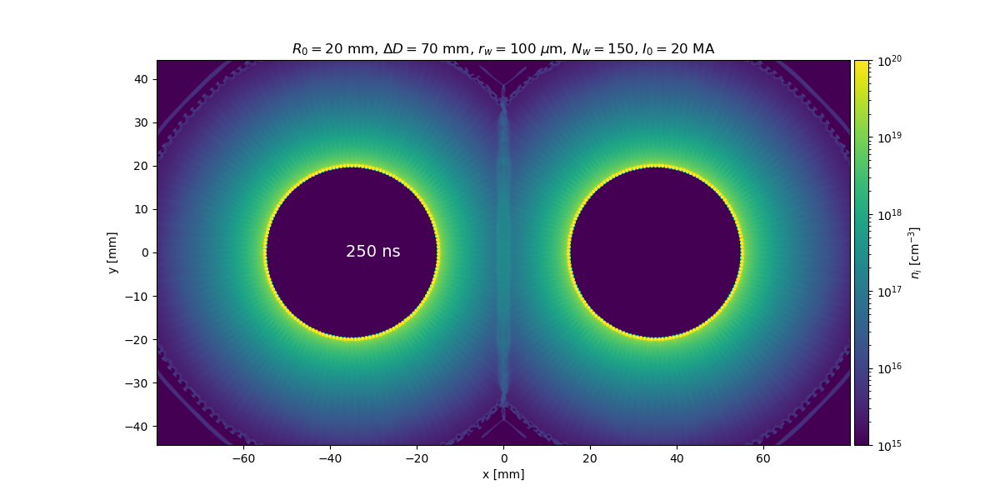

<IPython.core.display.Javascript object>


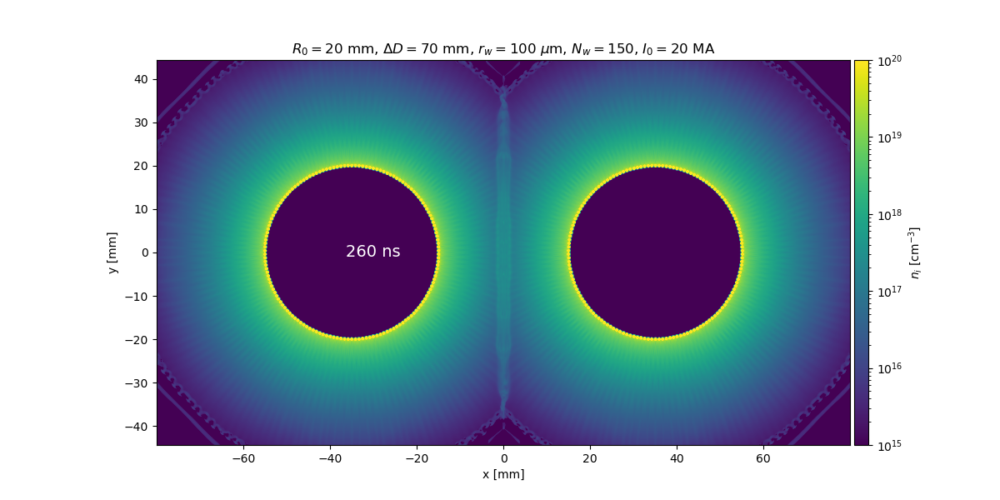

<IPython.core.display.Javascript object>


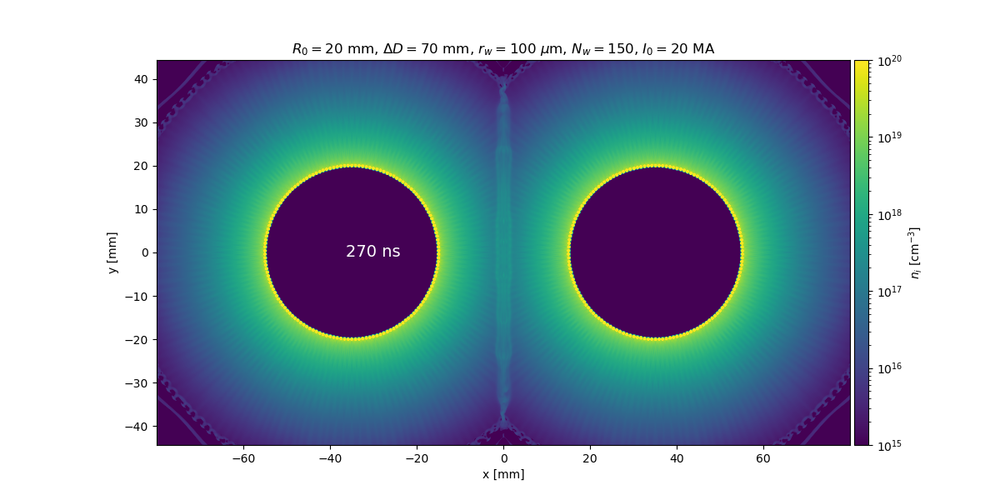

<IPython.core.display.Javascript object>


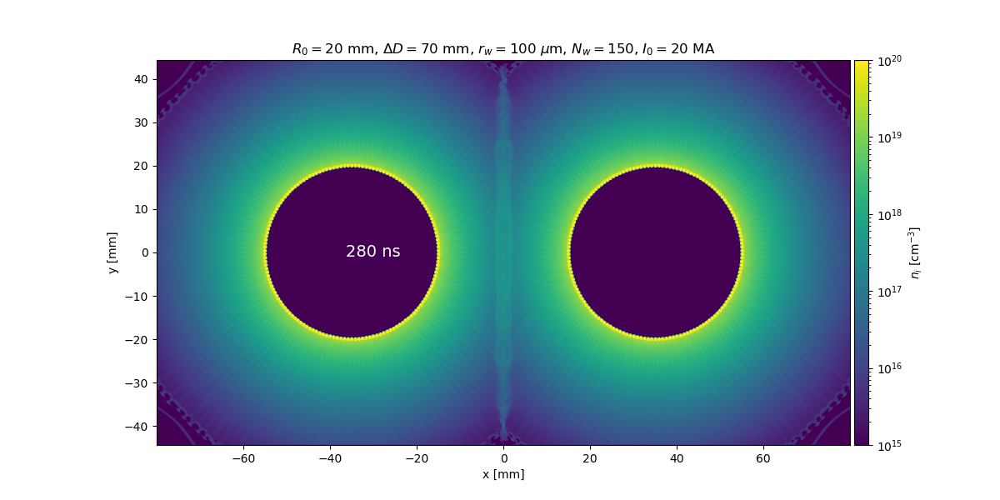

<IPython.core.display.Javascript object>


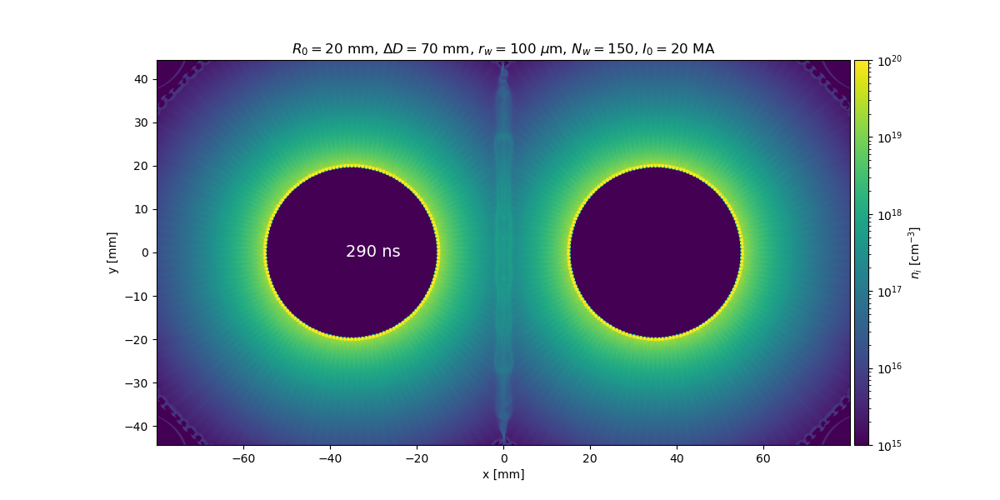

<IPython.core.display.Javascript object>


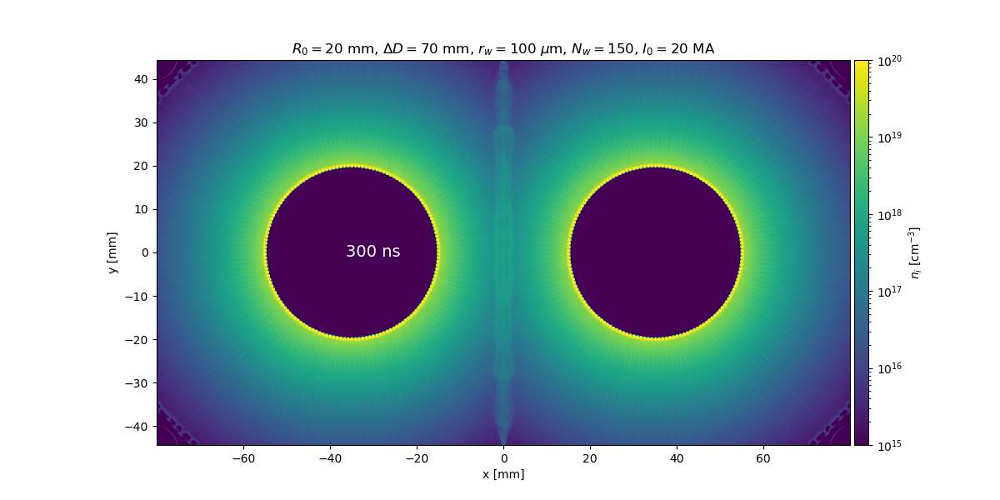

<IPython.core.display.Javascript object>


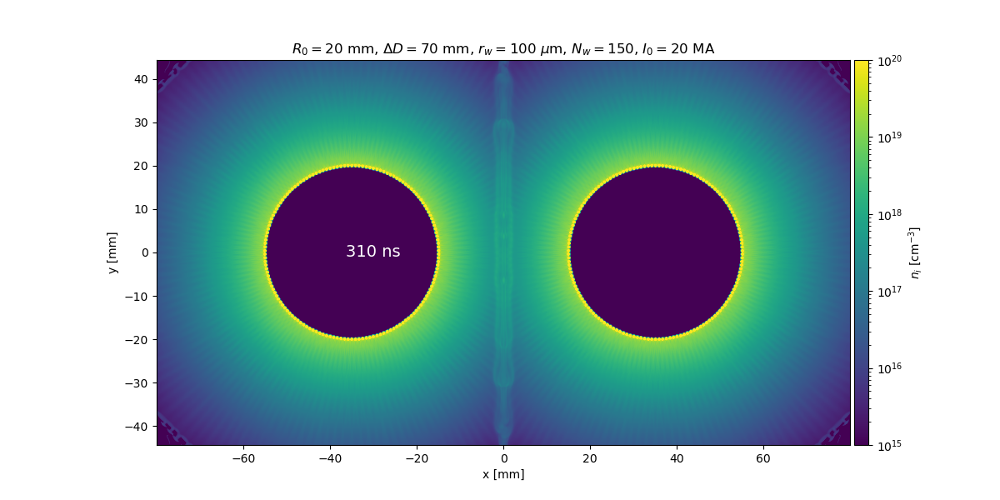

<IPython.core.display.Javascript object>


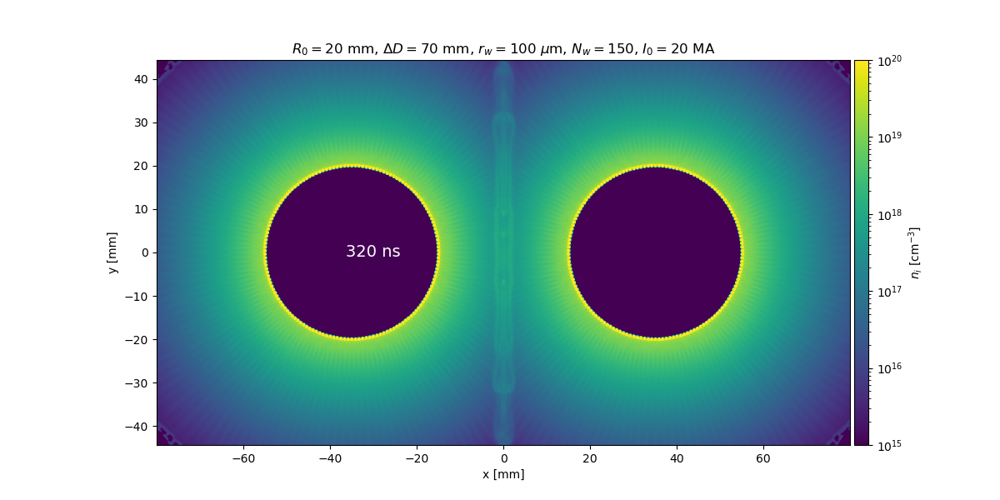

<IPython.core.display.Javascript object>


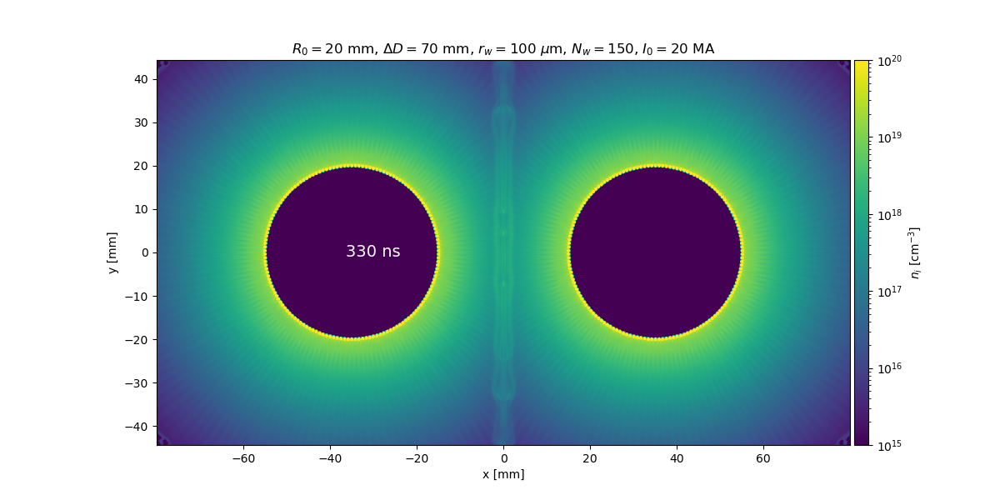

<IPython.core.display.Javascript object>


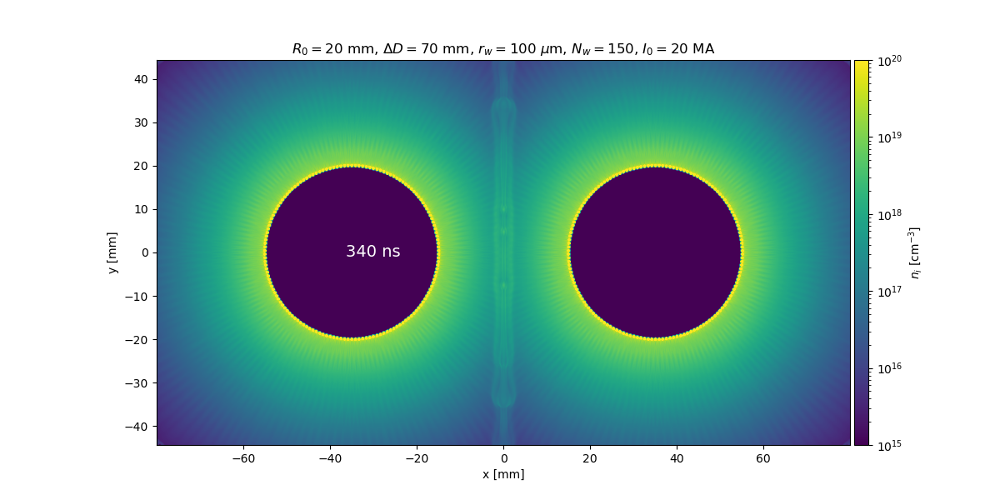

<IPython.core.display.Javascript object>


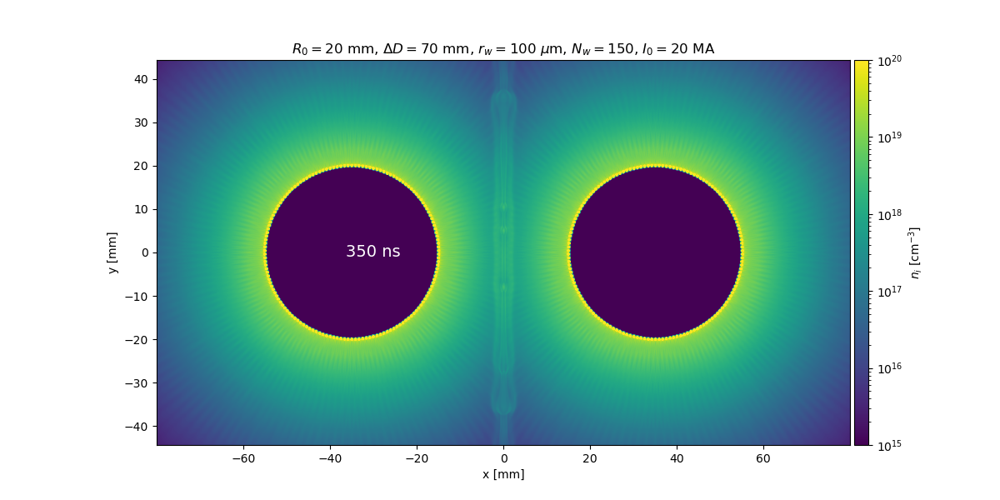

<IPython.core.display.Javascript object>


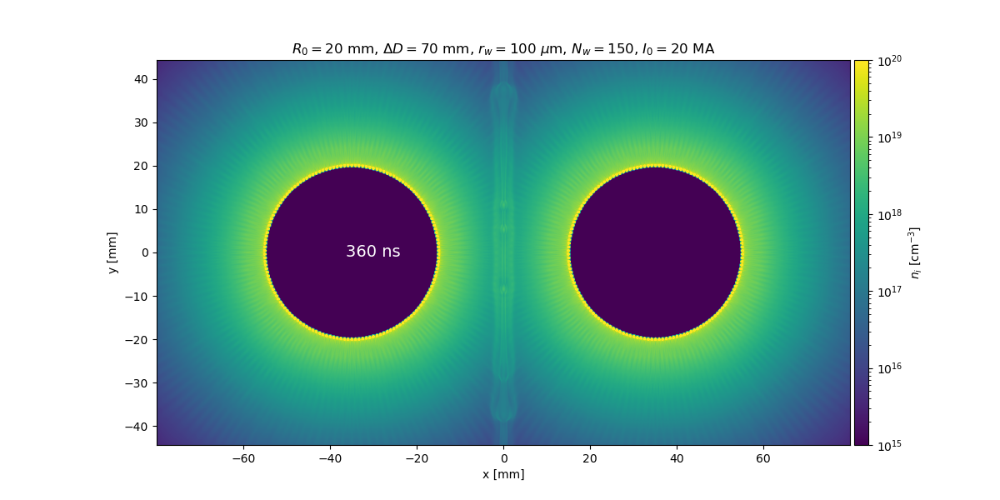

<IPython.core.display.Javascript object>


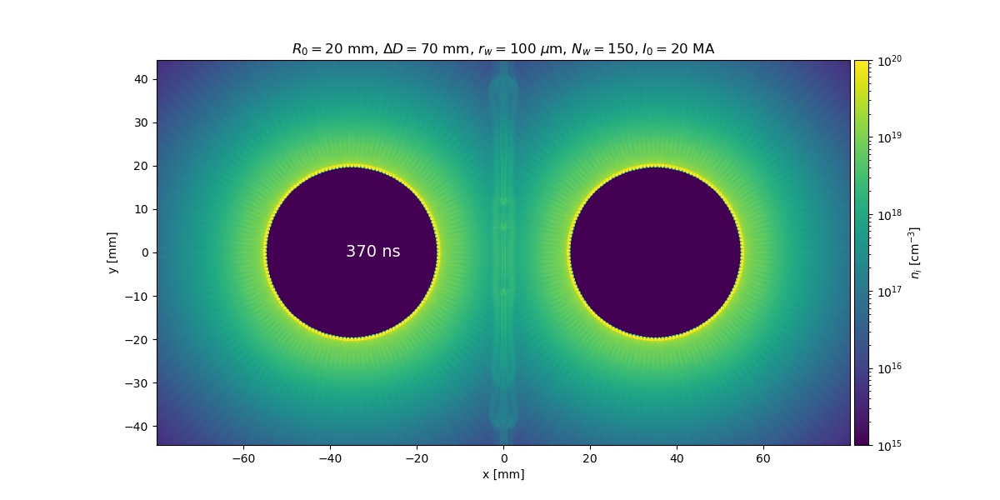

<IPython.core.display.Javascript object>


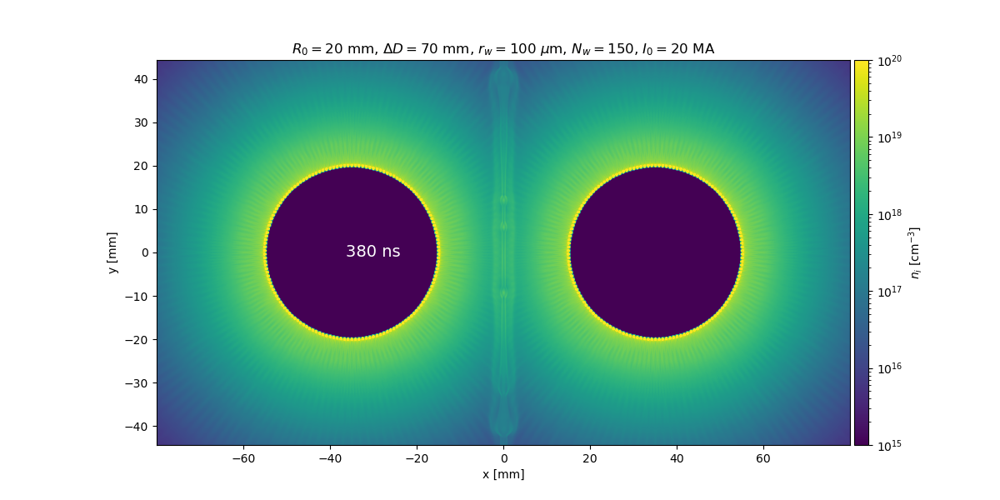

<IPython.core.display.Javascript object>


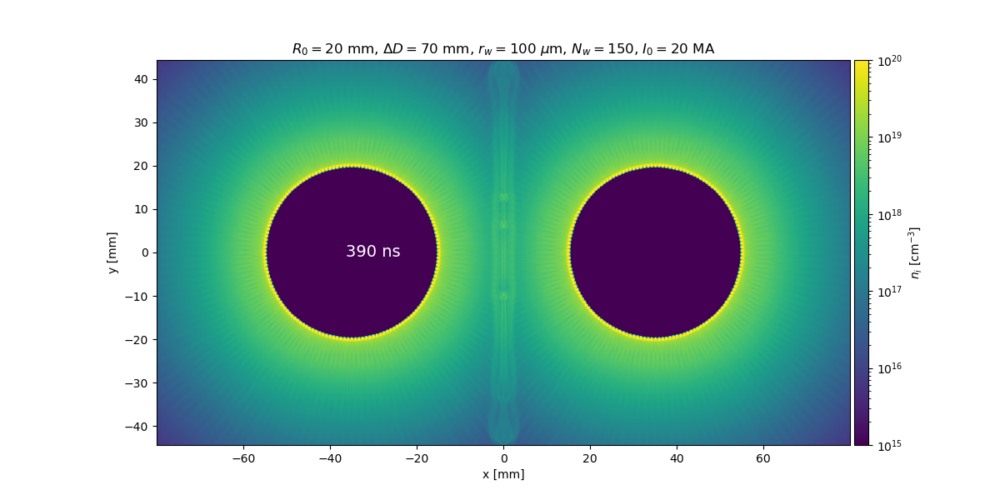

<IPython.core.display.Javascript object>


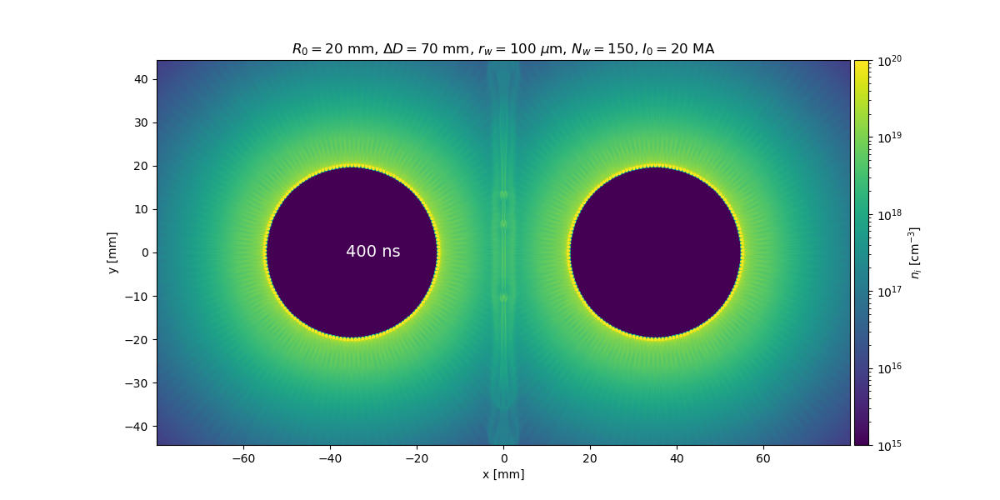

<IPython.core.display.Javascript object>


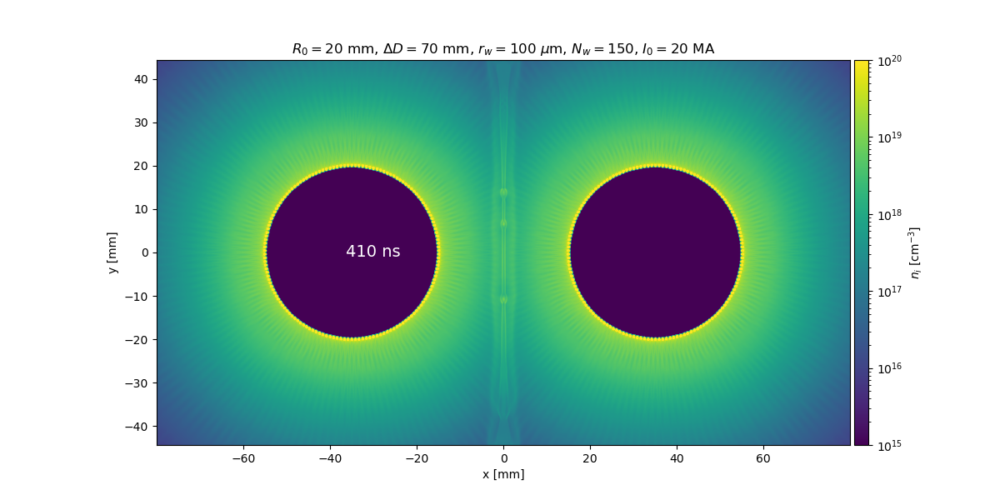

<IPython.core.display.Javascript object>


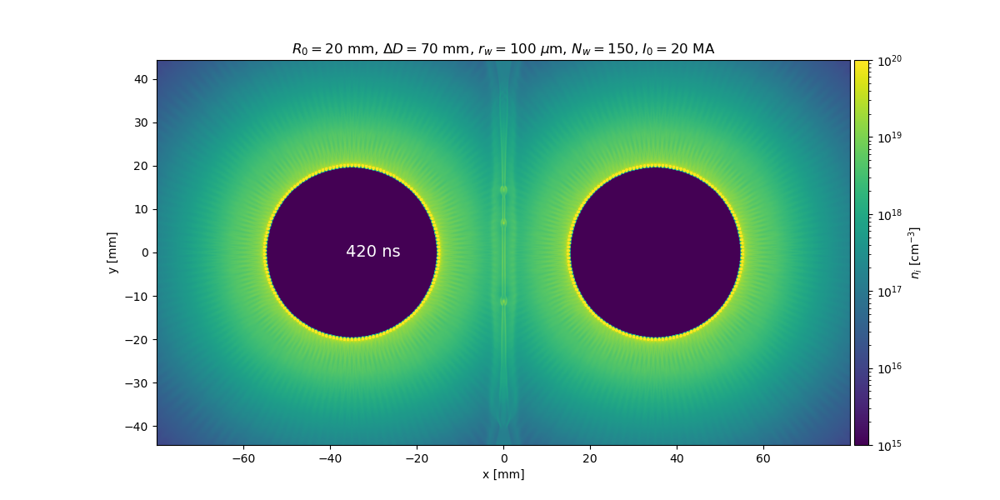

<IPython.core.display.Javascript object>


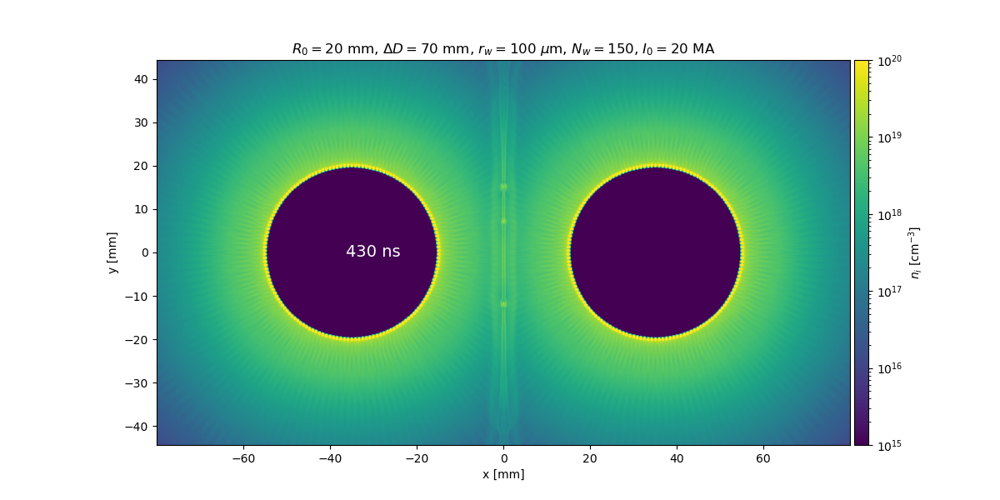

<IPython.core.display.Javascript object>


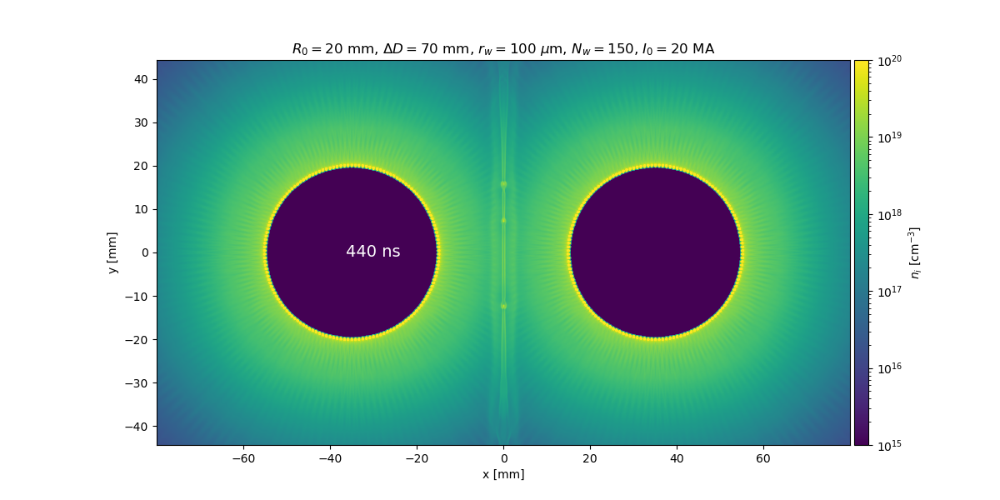

<IPython.core.display.Javascript object>


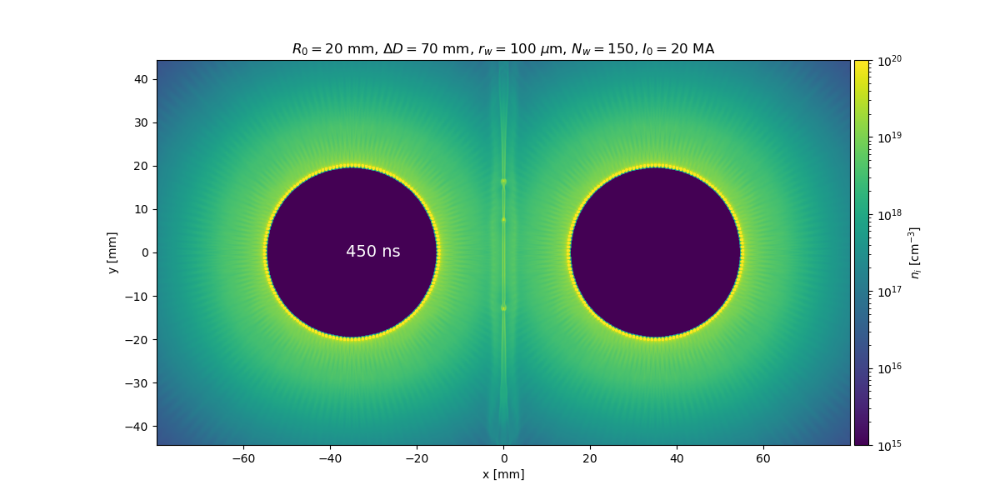

<IPython.core.display.Javascript object>


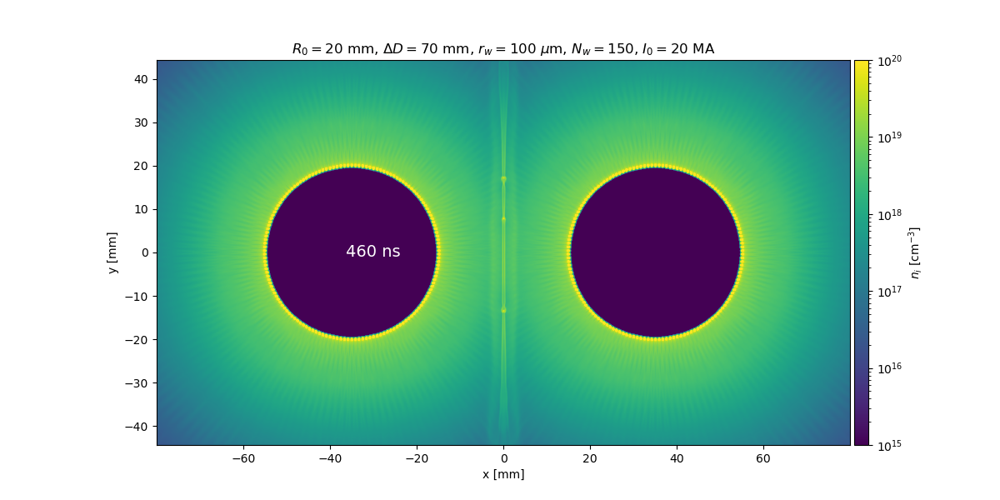

<IPython.core.display.Javascript object>


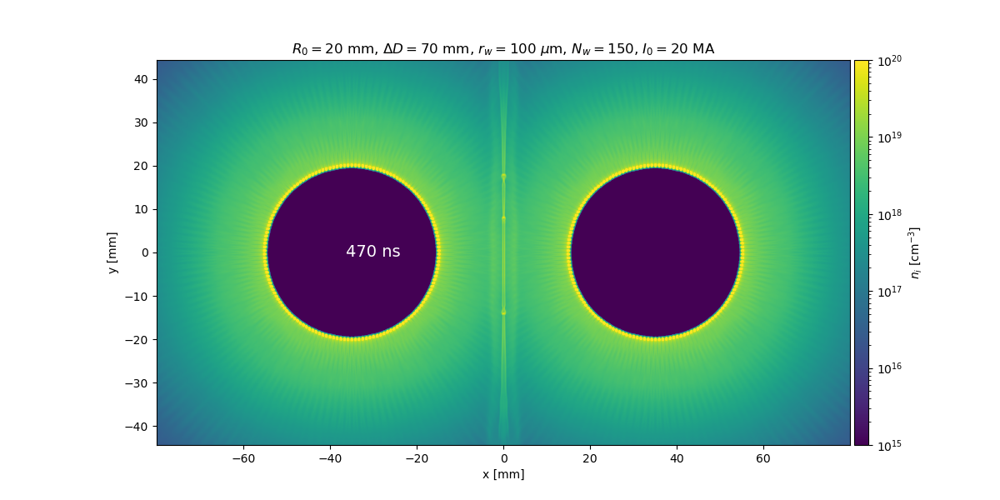

<IPython.core.display.Javascript object>


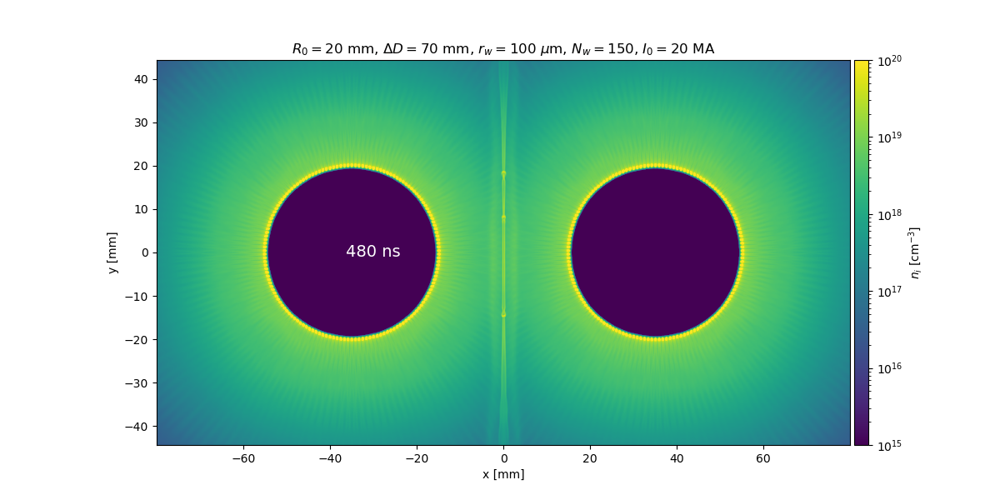

<IPython.core.display.Javascript object>


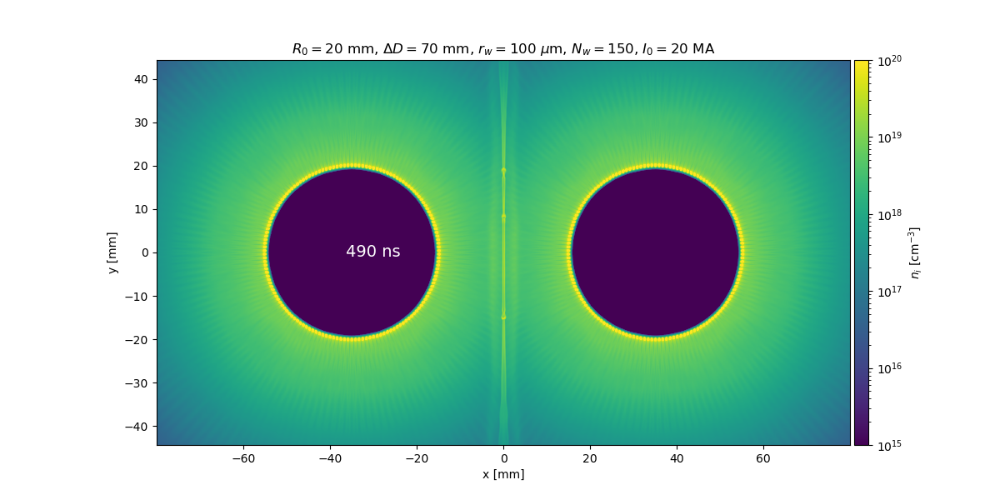

<IPython.core.display.Javascript object>


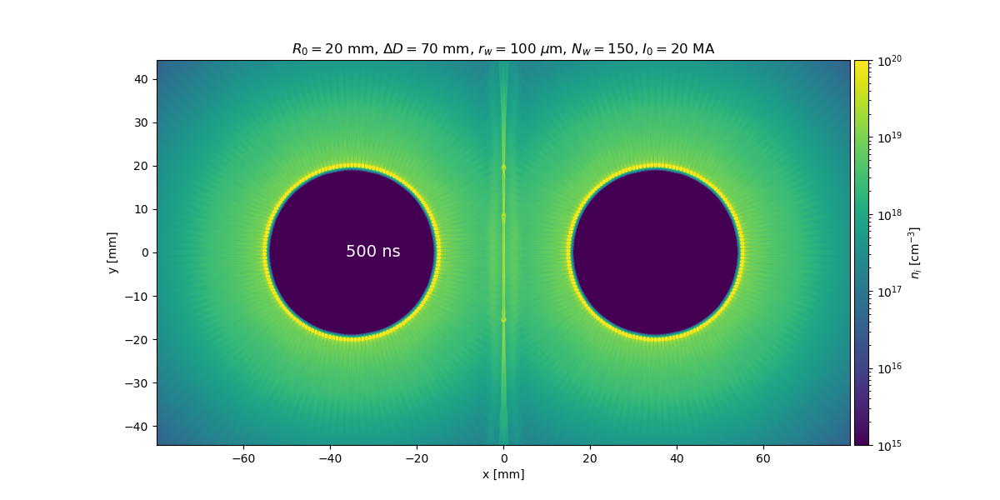

In [162]:
import matplotlib
import matplotlib.pyplot as plt
import numpy as np
import imageio

run = 'xy00'
quantity ='rho'

def plot_frame(t):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)
    rho,dim,spacing = pvti_readin(file)

    n_i = rho/rho_2_ions_per_cm3

    fig, ax = plt.subplots(figsize = (12,6), dpi=100)

    im = ax.imshow(n_i[:,:,zm_idx].T, norm=LogNorm(vmin=1e15, vmax=1e20), extent=[-x_ext, x_ext, -y_ext, y_ext])
    #ax.set_xlim([-40,40])
    #ax.set_ylim([-20,20])

    divider0 = make_axes_locatable(ax)
    c = divider0.append_axes('right',size="2%", pad=0.05)
    fig.colorbar(im, cax = c, label = r'$n_i$ [cm$^{-3}$]')

    ax.text(-30, 0, str(time)+' ns', color='w', ha='center', va='center', fontsize=14)
    
    ax.set_xlabel('x [mm]')
    ax.set_ylabel('y [mm]')
    ax.set_title(xy00_str)

    # Used to return the plot as an image rray
    fig.canvas.draw()       # draw the canvas, cache the renderer
    image = np.frombuffer(fig.canvas.tostring_rgb(), dtype='uint8')
    image  = image.reshape(fig.canvas.get_width_height()[::-1] + (3,))
    plt.close(fig) #prevents a large number of figures from being shown.
    
    return image

imageio.mimsave(run + '_'+quantity+'_lr.gif', [plot_frame(t) for t in np.arange(0,510,10)], fps=4)

## Vector data ##

In [49]:
base_folder = '/home/jdhare/GORGON/nsf_puffin/reconnection2D/'
run = 'xy00'
quantity ='Bvec'
time = 360
fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
file = os.path.join(base_folder,run, fn)

Bvec,dim,spacing = pvti_readin(file)

<IPython.core.display.Javascript object>


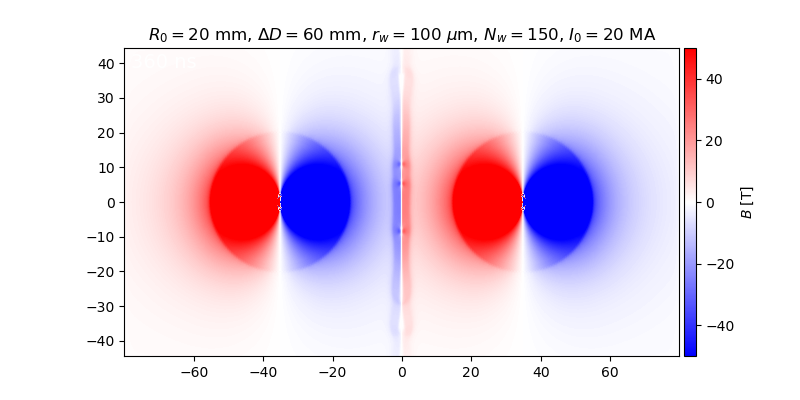

Text(0.5, 1.0, '$R_0 = 20$ mm, $\\Delta D = 60$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [74]:
run = 'xy00'
quantity ='Bvec'
time = 360
fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
file = os.path.join(base_folder,run, fn)

Bvec,dim,spacing = pvti_readin(file)

B_y = Bvec[:,:,0,1]
B_x = Bvec[:,:,0,0]
B = np.sqrt(B_x**2+B_y**2)

fig, ax = plt.subplots(figsize = (8,4))

im = ax.imshow(B_y.T, extent=[-x_ext, x_ext, -y_ext, y_ext], clim = [-50,50], cmap = 'bwr')

divider0 = make_axes_locatable(ax)
c = divider0.append_axes('right',size="2%", pad=0.05)
fig.colorbar(im, cax = c, label = r'$B$ [T]')

ax.text(-78, 43, str(time)+' ns', color='w', ha='left', va='top', fontsize=14)

ax.set_title(xy03_str)

<IPython.core.display.Javascript object>


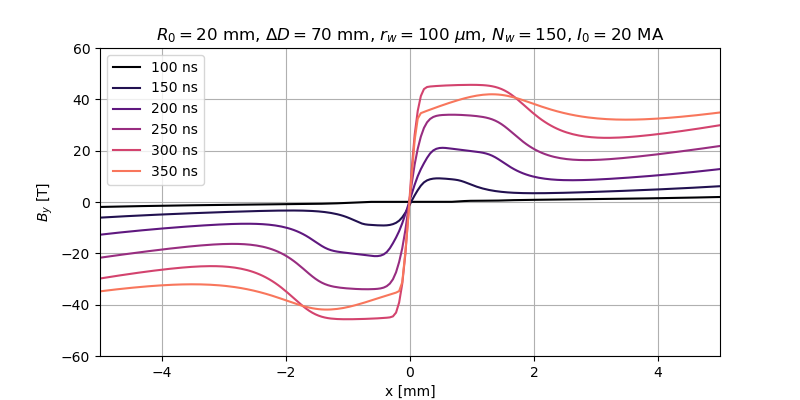

Text(0.5, 1.0, '$R_0 = 20$ mm, $\\Delta D = 70$ mm, $r_w = 100$ $\\mu$m, $N_w=$150, $I_0 = 20$ MA')

In [69]:
run = 'xy03'
quantity ='Bvec'

fig, ax = plt.subplots(figsize = (8,4))

ax.set_prop_cycle('color',[plt.cm.magma(i) for i in np.linspace(0, 1, 8)])

for t in np.arange(100,400,50):
    time = t
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)

    Bvec,dim,spacing = pvti_readin(file)

    B_y = Bvec[:,:,0,1]
    #B_x = Bvec[:,:,0,0]
    #B = np.sqrt(B_x**2+B_y**2)

    Δy = 1e-3/spacing[0]
    By_x = B_y[:,int(ym_idx-Δy):int(ym_idx+Δy)].mean(axis = 1)

    #ax.semilogy(x*1e3,rho[:,ym_idx,zm_idx])
    ax.plot(x*1e3,By_x, label = str(t)+' ns')
    

ax.set_xlim([-5,5])
#ax.set_ylim([1e-2,1])
ax.set_ylim([-60,60])

ax.grid()
ax.set_xlabel('x [mm]')
ax.set_ylabel(r'$B_y$ [T]')

ax.legend(loc = 2, fontsize=10)
 
ax.set_title(xy00_str)

In [157]:
import sys
sys.path.append("/home/jdhare/Documents/magpie_tools/code")
import plasma_parameter_calculator as ppc

run = 'xy00'

def Plasma_Params(run, time, L):
    ΔX = 5e-4 #layer half width, determined by inspection
    ΔY = 1e-3

    quantity = 'Bvec'
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)
    Bvec,dim,spacing = pvti_readin(file)
    # Define the x,y,z midplane indices
    xm_idx = dim[0]//2
    ym_idx = dim[1]//2
    
    dx_ind = int(ΔX/spacing[0])
    dy_ind = int(ΔY/spacing[0])
    
    B_y = Bvec[xm_idx+dx_ind,ym_idx,0,1] #B_y outside reconnection layer
    
    quantity = 'vvec'
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)
    vvec,dim,spacing = pvti_readin(file)
    v_x = vvec[xm_idx-dx_ind,ym_idx,0,0] #v_x outside reconnection layer
    
    quantity = 'rho'
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)
    rho,dim,spacing = pvti_readin(file)
    rho = rho[xm_idx,ym_idx-dy_ind:ym_idx+dy_ind,0].mean() #average over some range to avoid plasmoid perturbations
    
    quantity = 'Te'
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)
    T_e,dim,spacing = pvti_readin(file)
    T_e = T_e[xm_idx,ym_idx-dy_ind:ym_idx+dy_ind,0].mean() #average over some range to avoid plasmoid perturbations
    
    quantity = 'Ti'
    fn = 'x'+run[-2:]+'_'+quantity+'-'+str(time)+'.pvti'
    file = os.path.join(base_folder,run, fn)
    T_i,dim,spacing = pvti_readin(file)
    T_i = T_i[xm_idx,ym_idx-dy_ind:ym_idx+dy_ind,0].mean() #average over some range to avoid plasmoid perturbations

    n_i = rho/rho_2_ions_per_cm3
    Z = 7
    n_e = Z*n_i
        
    al_flow={'A':27,'Z':Z,'n_e':n_e,'T_e': T_e,'T_i':T_i,'B': B_y, 'V':v_x,'L':L}
    al=ppc.Plasma(**al_flow)
    
    return al

In [129]:
times = np.arange(100, 370, 10)
S_xy00 = [Plasma_Params('xy00', t, L = 35/2).S for t in times]
S_xy02 = [Plasma_Params('xy02', t, L = 30/2).S for t in times]
S_xy03 = [Plasma_Params('xy03', t, L = 30/2).S for t in times]

/home/jdhare/.conda/envs/jdhare/lib/python3.6/site-packages/ipykernel_launcher.py:142: RuntimeWarning: invalid value encountered in log
/home/jdhare/.conda/envs/jdhare/lib/python3.6/site-packages/ipykernel_launcher.py:86: RuntimeWarning: divide by zero encountered in double_scalars
/home/jdhare/.conda/envs/jdhare/lib/python3.6/site-packages/ipykernel_launcher.py:104: RuntimeWarning: divide by zero encountered in double_scalars
/home/jdhare/.conda/envs/jdhare/lib/python3.6/site-packages/ipykernel_launcher.py:129: RuntimeWarning: invalid value encountered in double_scalars


<IPython.core.display.Javascript object>


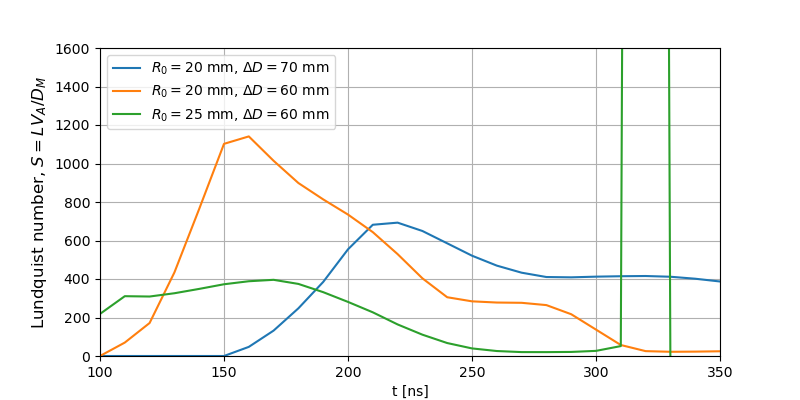

In [130]:
fig, ax = plt.subplots(figsize = (8,4))

ax.plot(times, S_xy00, label = xy00_str[:33])
ax.plot(times, S_xy03, label = xy03_str[:33])
ax.plot(times, S_xy02, label = xy02_str[:33])

ax.set_xlabel('t [ns]')
ax.set_ylabel(r'Lundquist number, $S = L V_A/D_M$', fontsize = 12)

ax.set_xlim([100, 350])
ax.set_ylim([0, 1600])

ax.legend()
ax.grid()

In [158]:
times = np.arange(100, 510, 10)
S_xy00 = [Plasma_Params('xy00', t, L = 35/2).S for t in times]

/home/jdhare/Documents/magpie_tools/code/plasma_parameter_calculator.py:142: RuntimeWarning: invalid value encountered in log
  self.col_log_ee=23.5-np.log(n_e**0.5*T_e**-1.25)-(1e-5+((np.log(T_e-2))**2)/16.0)**0.5
/home/jdhare/Documents/magpie_tools/code/plasma_parameter_calculator.py:86: RuntimeWarning: divide by zero encountered in double_scalars
  self.tau_ie_cooling=T_i/(Z*(T_e-T_i))*self.tau_E_ei
/home/jdhare/Documents/magpie_tools/code/plasma_parameter_calculator.py:104: RuntimeWarning: divide by zero encountered in double_scalars
  self.l_visc=(self.visc/self.V) # Re=1, viscous time scale= advective time scale
/home/jdhare/Documents/magpie_tools/code/plasma_parameter_calculator.py:129: RuntimeWarning: invalid value encountered in double_scalars
  self.Pr_M=self.Re_M/self.Re


<IPython.core.display.Javascript object>


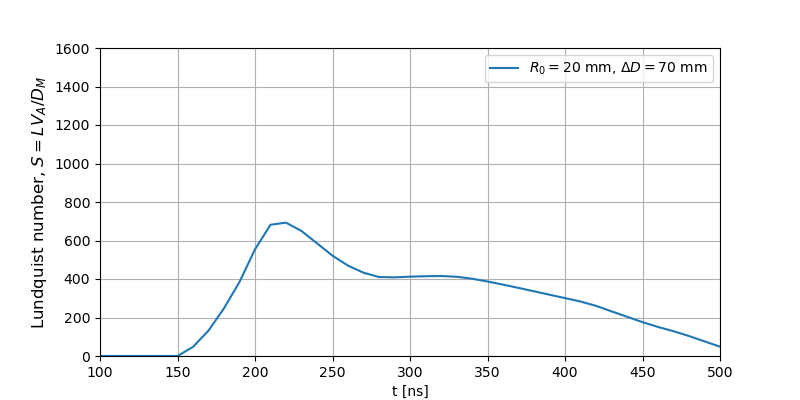

In [160]:
fig, ax = plt.subplots(figsize = (8,4))

ax.plot(times, S_xy00, label = xy00_str[:33])

ax.set_xlabel('t [ns]')
ax.set_ylabel(r'Lundquist number, $S = L V_A/D_M$', fontsize = 12)

ax.set_xlim([100, 500])
ax.set_ylim([0, 1600])

ax.legend()
ax.grid()

## MAGPIE

## Line integration ##

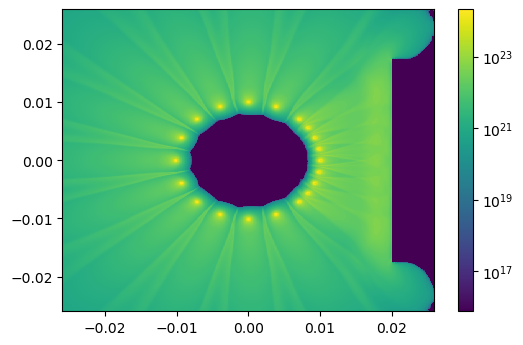

In [18]:
fig = plt.figure(dpi=100)

# Line integral along z
neL_z = spacing[2]*np.sum(ne,axis=2).T

plt.pcolormesh(XX,YY,neL_z,norm=LogNorm())
plt.colorbar()

In [22]:
np.savetxt("/rds/general/project/plasma-physics-archive-2019/live/ac116/data/neL_xy-400ns.dat",neL_z)

In [71]:
al_flow={'A':27,'Z':5,'n_e':1e20,'T_e': 100,'T_i':100,'B': 2, 'V':50e3,'L':7.25}
al=Plasma(**al_flow)

In [ ]:
ppc.